In [1]:
import numpy as np
import copy
from sklearn.neighbors import KernelDensity
import matplotlib.pyplot as plt
import numpy.random as rd
import pandas as pd

In [2]:
class ParticleFilter(object):
    def __init__(self, y, n_particle, sigma_2, alpha_2):
        self.y = y
        self.n_particle = n_particle
        self.sigma_2 = sigma_2
        self.alpha_2 = alpha_2
        self.log_likelihood = -np.inf

    def norm_likelihood(self, y, x, s2):
        return (np.sqrt(2 * np.pi * s2)) ** (-1) * np.exp(-(y - x) ** 2 / (2 * s2))

    def F_inv(self, w_cumsum, idx, u):
        # print(f"u: {u}")
        if np.any(w_cumsum < u) == False:
            return 0
        k = np.max(idx[w_cumsum < u])
        return k + 1

    def resampling(self, weights):
        '''
        generate x_resampled[t+1] = x[t+1, k]

        '''
        w_cumsum = np.cumsum(weights)
        idx = np.asanyarray(range(self.n_particle))
        # print(f"idx shape: {idx.shape}")
        k_list = np.zeros(self.n_particle, dtype=np.int32)  # サンプリングしたkのリスト格納場所

        # 一様分布から重みに応じてリサンプリングする添え字を取得
        for i, u in enumerate(rd.uniform(0, 1, size=self.n_particle)):
            k = self.F_inv(w_cumsum, idx, u)
            k_list[i] = k
        return k_list

    def resampling2(self, weights):
        """
        計算量の少ない層化サンプリング
        """
        idx = np.asanyarray(range(self.n_particle))

        u0 = rd.uniform(0, 1 / self.n_particle)
        u = [1 / self.n_particle * i + u0 for i in range(self.n_particle)]
        w_cumsum = np.cumsum(weights)
        k = np.asanyarray([self.F_inv(w_cumsum, idx, val) for val in u])
        return k

    def gen_price_diff_dist(self, t):
        ## changed to px returns
        self.price_diff_dist = np.asarray(
            np.unique(np.diff(self.y, 1)[t - self.roll_window:t]/ self.y[t - self.roll_window:t],
                      return_counts=True)).T

        self.price_diff_dist[:, 1] = self.price_diff_dist[:, 1] / self.price_diff_dist[:, 1].sum()
        # self.price_diff_dist = pd.DataFrame(self.price_diff_dist, columns=['price_diff', 'likelihood'])

    def likelihood_price_dist_lookup(self, y, x):

        ## shift price diff dist by particle price (x) to get price dist of x
        p_dist = copy.deepcopy(self.price_diff_dist)
        p_dist[:, 0] = p_dist[:, 0] + x

        # print(f"y: {y} p_dist[:,0]: {p_dist[:,0]}")
        idx_likelihood = np.searchsorted(p_dist[:, 0], y, side='left')

        try:

            return p_dist[idx_likelihood, 1]
        except:
            return p_dist[idx_likelihood - 1, 1]

    def gen_v(self):
        return np.random.choice(self.price_diff_dist[:, 0], size=1, p=self.price_diff_dist[:, 1])[0]

    def neff(self, weights):
        '''
        calculate “effective sample size (ESS)"
        '''
        return 1. / np.sum(np.square(weights))

    def get_x_dist(self, x, t):

        x_dist = np.asarray(np.unique(x[t, :], return_counts=True)).T
        # print("calc x_dist")
        # print(x_dist)
        x_dist[:, 1] = x_dist[:, 1] / x_dist[:, 1].sum()
        return x_dist

    def backward_smoother(self, w_normed, x, t):

        ## x[t+1, :] is the current particles
        ## w_normed[t] is the current normalised weight
        ## x[t, :] is the previous particles
        ## w_normed[t-1] is the previous normalised weight

        # print(f"prev_x_dist: {prev_x_dist}")

        # w_smoother = np.zeros( self.n_particle)

        denoms = np.zeros(self.n_particle)
        for j in range(self.n_particle):
            # print(f"x[t+1, j]: {x[t+1, j]}")

            for k in range(self.n_particle):
                #                 print(f"w_normed[t-1,k]: {w_normed[t-1,k]}")
                #                 print(f"prev_x_dist: {prev_x_dist}")
                #                 print(f"self.likelihood_price_dist_lookup(prev_x_dist, x[t+1, j]): {self.likelihood_price_dist_lookup(prev_x_dist, x[t+1, j])}")
                denoms[j] += w_normed[t - 1, k] * self.likelihood_price_dist_lookup(x[t + 1, j], x[t, k])

            # denoms[j] = sum([w_normed[t-1,k] * self.likelihood_price_dist_lookup(prev_x_dist, x[t+1, j]) for k in range(self.n_particle)])

        for i in range(self.n_particle):
            # print(f"i: {i}")
            p_j = np.zeros(self.n_particle)
            for j in range(self.n_particle):
                p_j[j] = self.likelihood_price_dist_lookup(x[t + 1, j], x[t, i])

            # print(f"dim check {w_normed[t]} {p_j} {denoms}")
            sum_j = np.sum(w_normed[t] * p_j / denoms)
            w_normed[t, i] = w_normed[t - 1, i] * sum_j

        return w_normed

    def simulate(self, roll_window, method, smoother='fixed_lag', seed=71):

        self.roll_window = roll_window
        self.method = method
        rd.seed(seed)

        if smoother == 'fixed_lag':
            counter = 0

        # 時系列データ数
        T = len(self.y)

        # 潜在変数
        x = np.zeros((T + 1, self.n_particle))
        x_resampled = np.zeros((T + 1, self.n_particle))

        # 潜在変数の初期値
        # initial_x = rd.normal(0, 1, size=self.n_particle)

        initial_x = 0 #self.y[roll_window - 1]

        x[roll_window] = x_resampled[roll_window] = initial_x
        

        # 重み
        w = np.zeros((T, self.n_particle))
        w_normed = np.zeros((T, self.n_particle))

        l = np.zeros(T)  # 時刻毎の尤度

        for t in range(T):
            print(f"t:{t}")
            if t < self.roll_window:
                pass


            else:
                # print("\r calculating... t={}".format(t), end="")

                self.gen_price_diff_dist(t)

                print(f"px diff dist: {self.price_diff_dist}")

                # print(f"v dist: {np.average(self.price_diff_dist['price_diff'],weights=self.price_diff_dist['likelihood']) }")

                for i in range(self.n_particle):

                    # 1階差分トレンドを適用

                    ## draw sample noise from rolling window
                    # v = rd.normal(0, np.sqrt(self.alpha_2*self.sigma_2)) # System Noise

                    if method == 'emp':
                        v = self.gen_v()
                        print(f"v: {v}")
                        print(f"x_resampled[t, i]: {x_resampled[t, i]}")
                        x[t + 1, i] = x_resampled[t, i] + v  # システムノイズの付加
                        print(f"x[t + 1, i]: {x[t + 1, i]}")
                        w[t, i] = self.likelihood_price_dist_lookup(self.y[t], x[t + 1, i])
                    elif method == 'normal':
                        v = rd.normal(0, np.sqrt(self.alpha_2 * self.sigma_2))  # System Noise
                        x[t + 1, i] = x_resampled[t, i] + v  # システムノイズの付加
                        w[t, i] = self.norm_likelihood(self.y[t], x[t + 1, i],
                                                       self.sigma_2)  # y[t]Likelihood of each particle with respect to
                print("x")
                print(x[t+1])
                print("w")
                print(w[t])
                w_normed[t] = w[t] / np.sum(w[t])  # 規格化

                _unsmoothed_w_normed_t = copy.deepcopy(w_normed[t])

                l[t] = np.log(np.sum(w[t]))  # 各時刻対数尤度

                #                 print('w_normed')
                #                 print(w_normed)

                ##Smoother

                if smoother:
                    if smoother == 'fixed_lag':
                        if counter == 0:
                            k = self.resampling(w_normed[t])  # リサンプルで取得した粒子の添字
                            x_resampled[t + 1] = x[t + 1, k]
                            counter += 1
                        else:
                            x_resampled[t + 1] = x[t + 1, :]
                            counter -= 1

                    if smoother == 'backward':
                        if t != self.roll_window:
                            w_normed = self.backward_smoother(w_normed, x, t)
                            w_normed[t] = w_normed[t] / np.sum(w_normed[t])

                        k = self.resampling(w_normed[t])
                        x_resampled[t + 1] = x[t + 1, k]

                    if smoother == 'ess':
                        if self.neff(w_normed[t]) < self.n_particle / 2:
                            k = self.resampling(w_normed[t])  # リサンプルで取得した粒子の添字
                            x_resampled[t + 1] = x[t + 1, k]
                        else:
                            x_resampled[t + 1] = x[t + 1, :]


                else:
                    k = self.resampling(w_normed[t])
                    x_resampled[t + 1] = x[t + 1, k]

                # 全体の対数尤度
                self.log_likelihood = np.sum(l) - T * np.log(self.n_particle)

                self.x = x
                self.x_resampled = x_resampled
                self.w = w
                self.w_normed = w_normed
                self.l = l

    def get_filtered_value(self, lagged_weight):
        """
        尤度の重みで加重平均した値でフィルタリングされ値を算出
        """
        shifted_n = 1
        ## these are px returns
        x_mean = np.diag(np.dot(self.w_normed, self.x[1:].T))
        x_mean = self.y *(x_mean+1)
        self.x_mean = x_mean

        shifted_x_mean = np.roll(self.x_mean, shifted_n)
        shifted_x_mean[:shifted_n] = self.x_mean[:shifted_n]
        shifted_x_mean[self.roll_window] = self.x_mean[self.roll_window]

        return (1 - lagged_weight) * x_mean + lagged_weight * shifted_x_mean

    def draw_graph(self, lagged_weight=0):
        # グラフ描画
        T = len(self.y)

        t_x = np.arange(self.roll_window, T)
        plt.figure(figsize=(30, 20))
        plt.plot(t_x, self.y[self.roll_window:], c="b", label="simple_mid")
        x_mean = self.get_filtered_value(lagged_weight)[self.roll_window:]
        plt.plot(t_x, x_mean, c="g", label="pred")

        for t in t_x:
            plt.scatter(np.ones(self.n_particle) * t, self.x[t], color="r", s=2, alpha=0.1)

        plt.legend()

        mse = np.mean((self.y[self.roll_window:] - x_mean) ** 2)
        plt.title(self.method + "log likelihood={:.3f}".format(self.log_likelihood) + " MSE={:.3f}".format(mse))
        plt.show()

t:0
t:1
t:2
t:3
t:4
t:5
t:6
t:7
t:8
t:9
t:10
t:11
t:12
t:13
t:14
t:15
t:16
t:17
t:18
t:19
t:20
t:21
t:22
t:23
t:24
t:25
t:26
t:27
t:28
t:29
t:30
t:31
t:32
t:33
t:34
t:35
t:36
t:37
t:38
t:39
t:40
t:41
t:42
t:43
t:44
t:45
t:46
t:47
t:48
t:49
t:50
t:51
t:52
t:53
t:54
t:55
t:56
t:57
t:58
t:59
t:60
t:61
t:62
t:63
t:64
t:65
t:66
t:67
t:68
t:69
t:70
t:71
t:72
t:73
t:74
t:75
t:76
t:77
t:78
t:79
t:80
t:81
t:82
t:83
t:84
t:85
t:86
t:87
t:88
t:89
t:90
t:91
t:92
t:93
t:94
t:95
t:96
t:97
t:98
t:99
t:100
px diff dist: [[-1.39696509e-04  1.00000000e-02]
 [-8.73118430e-05  1.00000000e-02]
 [-6.98519139e-05  2.00000000e-02]
 [-6.98470350e-05  1.00000000e-02]
 [-3.49277868e-05  1.00000000e-02]
 [-3.49271768e-05  1.00000000e-02]
 [-1.74645034e-05  1.00000000e-02]
 [-1.74641984e-05  1.00000000e-02]
 [-1.74638934e-05  5.00000000e-02]
 [-1.74635884e-05  1.00000000e-02]
 [-1.74620637e-05  5.00000000e-02]
 [ 0.00000000e+00  6.40000000e-01]
 [ 1.74623686e-05  5.00000000e-02]
 [ 1.74638934e-05  1.00000000e-02]


px diff dist: [[-1.39696509e-04  1.00000000e-02]
 [-1.04776041e-04  1.00000000e-02]
 [-8.73118430e-05  1.00000000e-02]
 [-6.98519139e-05  1.00000000e-02]
 [-5.23935102e-05  1.00000000e-02]
 [-3.49277868e-05  1.00000000e-02]
 [-3.49271768e-05  1.00000000e-02]
 [-1.74645034e-05  2.00000000e-02]
 [-1.74641984e-05  1.00000000e-02]
 [-1.74638934e-05  5.00000000e-02]
 [-1.74635884e-05  1.00000000e-02]
 [-1.74620637e-05  5.00000000e-02]
 [ 0.00000000e+00  6.20000000e-01]
 [ 1.74623686e-05  5.00000000e-02]
 [ 1.74638934e-05  1.00000000e-02]
 [ 1.74641984e-05  4.00000000e-02]
 [ 3.49290068e-05  1.00000000e-02]
 [ 5.23962554e-05  1.00000000e-02]
 [ 6.98592336e-05  1.00000000e-02]
 [ 1.04785190e-04  1.00000000e-02]
 [ 1.04787020e-04  1.00000000e-02]
 [ 1.22249389e-04  1.00000000e-02]
 [ 1.57183276e-04  1.00000000e-02]]
v: 1.7464198393293748e-05
x_resampled[t, i]: -5.2377652040356235e-05
x[t + 1, i]: -3.4913453647062484e-05
v: 0.0
x_resampled[t, i]: -3.4900949971329907e-05
x[t + 1, i]: -3.49009499

v: 0.0
x_resampled[t, i]: 1.7485546671342843e-05
x[t + 1, i]: 1.7485546671342843e-05
v: 0.0
x_resampled[t, i]: 5.242461753833828e-05
x[t + 1, i]: 5.242461753833828e-05
v: 0.0
x_resampled[t, i]: -3.4893935113356384e-05
x[t + 1, i]: -3.4893935113356384e-05
v: 0.00010479251082855945
x_resampled[t, i]: 0.00013973768019004716
x[t + 1, i]: 0.0002445301910186066
v: -1.7463893400394685e-05
x_resampled[t, i]: 5.242583721166558e-05
x[t + 1, i]: 3.49619438112709e-05
v: 0.0
x_resampled[t, i]: -8.72871397039147e-05
x[t + 1, i]: -8.72871397039147e-05
v: 0.0
x_resampled[t, i]: 1.74879864760646e-05
x[t + 1, i]: 1.74879864760646e-05
v: 0.0
x_resampled[t, i]: 0.0001048260585668426
x[t + 1, i]: 0.0001048260585668426
v: -3.492778680078937e-05
x_resampled[t, i]: -3.489759444233912e-05
x[t + 1, i]: -6.982538124312849e-05
v: 0.0
x_resampled[t, i]: -8.729019052763611e-05
x[t + 1, i]: -8.729019052763611e-05
v: 1.7462368595676316e-05
x_resampled[t, i]: 3.498664572233538e-05
x[t + 1, i]: 5.244901431801169e-05
v:

v: 1.7464198393293748e-05
x_resampled[t, i]: -0.0001571445433694071
x[t + 1, i]: -0.00013968034497611334
v: -0.0001222387147472278
x_resampled[t, i]: 1.7492560144580887e-05
x[t + 1, i]: -0.00010474615460264692
v: 0.0
x_resampled[t, i]: 0.0002619782252781083
x[t + 1, i]: 0.0002619782252781083
v: -1.7462063666684128e-05
x_resampled[t, i]: 0.00017469108602164845
x[t + 1, i]: 0.0001572290223549643
v: 0.0
x_resampled[t, i]: 0.0002969063170717967
x[t + 1, i]: 0.0002969063170717967
v: 0.0
x_resampled[t, i]: 0.000279442118678503
x[t + 1, i]: 0.000279442118678503
v: 0.0
x_resampled[t, i]: 5.215054771898737e-08
x[t + 1, i]: 5.215054771898737e-08
v: 0.0
x_resampled[t, i]: 5.215054771898737e-08
x[t + 1, i]: 5.215054771898737e-08
v: 0.0
x_resampled[t, i]: 2.86667441862023e-08
x[t + 1, i]: 2.86667441862023e-08
v: 3.492900679369182e-05
x_resampled[t, i]: 0.00013973920553798144
x[t + 1, i]: 0.00017466821233167324
v: 0.0
x_resampled[t, i]: -3.487777126728354e-05
x[t + 1, i]: -3.487777126728354e-05
v: 0

v: 0.0
x_resampled[t, i]: 0.0008034004021536506
x[t + 1, i]: 0.0008034004021536506
v: 0.0
x_resampled[t, i]: 0.0006112734790211407
x[t + 1, i]: 0.0006112734790211407
v: 0.0
x_resampled[t, i]: 3.499213671300237e-05
x[t + 1, i]: 3.499213671300237e-05
v: 0.0
x_resampled[t, i]: -0.00017458098941135726
x[t + 1, i]: -0.00017458098941135726
v: 0.00015718327569946557
x_resampled[t, i]: 0.0005064864587359549
x[t + 1, i]: 0.0006636697344354204
v: 0.0
x_resampled[t, i]: 0.0005064864587359549
x[t + 1, i]: 0.0005064864587359549
v: 0.0
x_resampled[t, i]: 0.0003842358493721148
x[t + 1, i]: 0.0003842358493721148
v: 0.0
x_resampled[t, i]: 0.0001921473556327452
x[t + 1, i]: 0.0001921473556327452
v: -1.7462978485610506e-05
x_resampled[t, i]: 0.00040171407802481156
x[t + 1, i]: 0.00038425109953920105
v: 0.0
x_resampled[t, i]: 5.245664010984828e-05
x[t + 1, i]: 5.245664010984828e-05
v: 0.0
x_resampled[t, i]: 0.00024454086582328293
x[t + 1, i]: 0.00024454086582328293
v: 0.00015718327569946557
x_resampled[t,

px diff dist: [[-1.57169551e-04  1.00000000e-02]
 [-1.22238715e-04  1.00000000e-02]
 [-1.04781531e-04  1.00000000e-02]
 [-1.04776041e-04  1.00000000e-02]
 [-3.49296168e-05  1.00000000e-02]
 [-3.49241273e-05  1.00000000e-02]
 [-1.74645034e-05  1.00000000e-02]
 [-1.74629785e-05  1.00000000e-02]
 [-1.74626735e-05  1.00000000e-02]
 [ 0.00000000e+00  8.70000000e-01]
 [ 1.04792511e-04  1.00000000e-02]
 [ 1.57183276e-04  1.00000000e-02]
 [ 1.57188766e-04  1.00000000e-02]
 [ 1.57194257e-04  1.00000000e-02]]
v: 0.0
x_resampled[t, i]: 0.00034931690654516106
x[t + 1, i]: 0.00034931690654516106
v: 0.0
x_resampled[t, i]: 0.0001921336308456955
x[t + 1, i]: 0.0001921336308456955
v: 0.0
x_resampled[t, i]: 0.0001921336308456955
x[t + 1, i]: 0.0001921336308456955
v: 0.0
x_resampled[t, i]: 0.0001921473556327452
x[t + 1, i]: 0.0001921473556327452
v: 0.0
x_resampled[t, i]: 8.737131442083565e-05
x[t + 1, i]: 8.737131442083565e-05
v: 0.0
x_resampled[t, i]: 0.00029692614167425494
x[t + 1, i]: 0.00029692614167

v: 0.0
x_resampled[t, i]: 0.00024456679055011906
x[t + 1, i]: 0.00024456679055011906
v: 0.0
x_resampled[t, i]: 5.244840748517643e-05
x[t + 1, i]: 5.244840748517643e-05
v: 0.0
x_resampled[t, i]: -0.00017457305722059165
x[t + 1, i]: -0.00017457305722059165
v: 0.0
x_resampled[t, i]: 5.244840748517643e-05
x[t + 1, i]: 5.244840748517643e-05
v: 0.0
x_resampled[t, i]: 0.00019217602540219495
x[t + 1, i]: 0.00019217602540219495
v: 0.0
x_resampled[t, i]: 8.737802430727989e-05
x[t + 1, i]: 8.737802430727989e-05
v: 0.0
x_resampled[t, i]: 0.000279461638277409
x[t + 1, i]: 0.000279461638277409
v: 0.0
x_resampled[t, i]: -0.00027935367303839924
x[t + 1, i]: -0.00027935367303839924
v: 0.0
x_resampled[t, i]: 5.244840748517643e-05
x[t + 1, i]: 5.244840748517643e-05
v: 0.0
x_resampled[t, i]: 8.737802430727989e-05
x[t + 1, i]: 8.737802430727989e-05
v: 0.0
x_resampled[t, i]: 0.0005065855828349251
x[t + 1, i]: 0.0005065855828349251
v: 0.0
x_resampled[t, i]: 0.00017471152170708685
x[t + 1, i]: 0.0001747115217

v: 0.0
x_resampled[t, i]: 0.00026209137877352735
x[t + 1, i]: 0.00026209137877352735
v: 0.0
x_resampled[t, i]: 0.0004018229624080138
x[t + 1, i]: 0.0004018229624080138
v: 0.0
x_resampled[t, i]: 0.0004018229624080138
x[t + 1, i]: 0.0004018229624080138
v: 0.0
x_resampled[t, i]: -0.00010470253830639522
x[t + 1, i]: -0.00010470253830639522
v: 0.0
x_resampled[t, i]: 5.249537785140989e-05
x[t + 1, i]: 5.249537785140989e-05
v: 0.0
x_resampled[t, i]: 0.0008733468672300679
x[t + 1, i]: 0.0008733468672300679
v: 0.0
x_resampled[t, i]: 0.00019217968616937065
x[t + 1, i]: 0.00019217968616937065
v: 0.0
x_resampled[t, i]: 5.246701271258737e-05
x[t + 1, i]: 5.246701271258737e-05
v: 0.0
x_resampled[t, i]: 0.00019217968616937065
x[t + 1, i]: 0.00019217968616937065
v: 0.0
x_resampled[t, i]: 0.0004018229624080138
x[t + 1, i]: 0.0004018229624080138
v: 0.0
x_resampled[t, i]: -5.232336397526618e-05
x[t + 1, i]: -5.232336397526618e-05
v: 0.0
x_resampled[t, i]: -5.232336397526618e-05
x[t + 1, i]: -5.2323363975

v: 0.0
x_resampled[t, i]: -0.0001745584167943554
x[t + 1, i]: -0.0001745584167943554
v: 0.0
x_resampled[t, i]: -0.0001745584167943554
x[t + 1, i]: -0.0001745584167943554
v: 0.0
x_resampled[t, i]: -5.232336397526618e-05
x[t + 1, i]: -5.232336397526618e-05
v: 0.0
x_resampled[t, i]: -0.0001745584167943554
x[t + 1, i]: -0.0001745584167943554
v: 0.0
x_resampled[t, i]: -0.0001745584167943554
x[t + 1, i]: -0.0001745584167943554
v: 0.0
x_resampled[t, i]: -0.0001745584167943554
x[t + 1, i]: -0.0001745584167943554
v: 0.0
x_resampled[t, i]: 5.246701271258737e-05
x[t + 1, i]: 5.246701271258737e-05
v: 0.0
x_resampled[t, i]: -0.000331727967813338
x[t + 1, i]: -0.000331727967813338
v: 0.0
x_resampled[t, i]: -0.0001745584167943554
x[t + 1, i]: -0.0001745584167943554
v: 0.0
x_resampled[t, i]: -0.000331727967813338
x[t + 1, i]: -0.000331727967813338
v: 0.0
x_resampled[t, i]: -0.00020949291499424875
x[t + 1, i]: -0.00020949291499424875
v: 0.0
x_resampled[t, i]: 0.00022716572675259857
x[t + 1, i]: 0.00022

px diff dist: [[-1.57169551e-04  1.00000000e-02]
 [-1.57164062e-04  1.00000000e-02]
 [-3.49241273e-05  1.00000000e-02]
 [-3.49229077e-05  1.00000000e-02]
 [-1.74654185e-05  3.00000000e-02]
 [-1.74651134e-05  2.00000000e-02]
 [ 0.00000000e+00  8.40000000e-01]
 [ 1.74654185e-05  2.00000000e-02]
 [ 1.74657235e-05  2.00000000e-02]
 [ 3.49265669e-05  1.00000000e-02]
 [ 6.98506941e-05  1.00000000e-02]
 [ 1.57194257e-04  1.00000000e-02]]
v: 0.0
x_resampled[t, i]: -0.0003142625493419114
x[t + 1, i]: -0.0003142625493419114
v: 6.985069414127303e-05
x_resampled[t, i]: 1.7544105031293823e-05
x[t + 1, i]: 8.739479917256685e-05
v: 0.0
x_resampled[t, i]: 0.00012234607199268293
x[t + 1, i]: 0.00012234607199268293
v: 0.0
x_resampled[t, i]: -0.00015708507022248227
x[t + 1, i]: -0.00015708507022248227
v: 0.0
x_resampled[t, i]: -0.0003142625493419114
x[t + 1, i]: -0.0003142625493419114
v: 1.7465418471426575e-05
x_resampled[t, i]: 5.2470671924401065e-05
x[t + 1, i]: 6.993609039582764e-05
v: 0.0
x_resampled

v: 0.0
x_resampled[t, i]: -0.000244413076035062
x[t + 1, i]: -0.000244413076035062
v: 0.0
x_resampled[t, i]: -0.0006285918943232072
x[t + 1, i]: -0.0006285918943232072
v: 0.0
x_resampled[t, i]: -0.00020948071439396402
x[t + 1, i]: -0.00020948071439396402
v: 0.0
x_resampled[t, i]: -0.00013963123981956322
x[t + 1, i]: -0.00013963123981956322
v: 0.0
x_resampled[t, i]: 5.245389705911409e-05
x[t + 1, i]: 5.245389705911409e-05
v: 0.0
x_resampled[t, i]: 0.0007336634735393407
x[t + 1, i]: 0.0007336634735393407
v: 0.0
x_resampled[t, i]: -0.00020947796979871024
x[t + 1, i]: -0.00020947796979871024
v: -1.7465113435911766e-05
x_resampled[t, i]: -0.00015708842398326006
x[t + 1, i]: -0.00017455353741917183
v: 0.0
x_resampled[t, i]: 0.0006288740125758467
x[t + 1, i]: 0.0006288740125758467
v: 0.0
x_resampled[t, i]: -1.737270218484759e-05
x[t + 1, i]: -1.737270218484759e-05
v: 0.0
x_resampled[t, i]: -0.000244413076035062
x[t + 1, i]: -0.000244413076035062
v: 0.0
x_resampled[t, i]: -0.000174554147500856

v: 0.0
x_resampled[t, i]: 0.0006463369906354292
x[t + 1, i]: 0.0006463369906354292
v: 0.0
x_resampled[t, i]: 0.0007685903454679628
x[t + 1, i]: 0.0007685903454679628
v: 0.0
x_resampled[t, i]: 0.0007685903454679628
x[t + 1, i]: 0.0007685903454679628
v: 0.0
x_resampled[t, i]: -0.000349190642797268
x[t + 1, i]: -0.000349190642797268
v: 0.0
x_resampled[t, i]: 0.0006288718771995175
x[t + 1, i]: 0.0006288718771995175
v: 0.0
x_resampled[t, i]: -0.0002444106362302727
x[t + 1, i]: -0.0002444106362302727
v: 0.0
x_resampled[t, i]: 0.0005939739801504384
x[t + 1, i]: 0.0005939739801504384
v: 0.0
x_resampled[t, i]: -0.0003841172096903752
x[t + 1, i]: -0.0003841172096903752
v: 0.0
x_resampled[t, i]: -1.7367515473277342e-05
x[t + 1, i]: -1.7367515473277342e-05
v: 1.7465418471426575e-05
x_resampled[t, i]: 0.0006812647775214366
x[t + 1, i]: 0.0006987301959928632
v: 0.0
x_resampled[t, i]: 0.0007685903454679628
x[t + 1, i]: 0.0007685903454679628
v: 0.0
x_resampled[t, i]: -1.7367515473277342e-05
x[t + 1, i

v: 0.0
x_resampled[t, i]: 0.0005939489695182239
x[t + 1, i]: 0.0005939489695182239
v: 0.0
x_resampled[t, i]: 0.0011004390918336467
x[t + 1, i]: 0.0011004390918336467
v: 0.0
x_resampled[t, i]: 1.1101707516919957e-07
x[t + 1, i]: 1.1101707516919957e-07
v: 0.0
x_resampled[t, i]: -8.722674960747549e-05
x[t + 1, i]: -8.722674960747549e-05
v: 0.0
x_resampled[t, i]: -1.7355316396292015e-05
x[t + 1, i]: -1.7355316396292015e-05
v: 0.0
x_resampled[t, i]: 0.00040181198425092427
x[t + 1, i]: 0.00040181198425092427
v: 0.0
x_resampled[t, i]: -3.4796639714783096e-05
x[t + 1, i]: -3.4796639714783096e-05
v: 0.0
x_resampled[t, i]: -1.7358976119377458e-05
x[t + 1, i]: -1.7358976119377458e-05
v: 0.0
x_resampled[t, i]: -0.00010469216807890207
x[t + 1, i]: -0.00010469216807890207
v: 0.0
x_resampled[t, i]: 0.0005939489695182239
x[t + 1, i]: 0.0005939489695182239
v: 0.0
x_resampled[t, i]: -3.4796639714783096e-05
x[t + 1, i]: -3.4796639714783096e-05
v: 1.7465723517596715e-05
x_resampled[t, i]: 0.00057648385608

v: -1.7465418471426575e-05
x_resampled[t, i]: -3.479572817667637e-05
x[t + 1, i]: -5.226114664810294e-05
v: -1.7465418471426575e-05
x_resampled[t, i]: 0.0008384721484058744
x[t + 1, i]: 0.0008210067299344478
v: -1.746175874834113e-05
x_resampled[t, i]: 0.0006463125927158046
x[t + 1, i]: 0.0006288508339674635
v: 0.0
x_resampled[t, i]: 0.0004716760976537661
x[t + 1, i]: 0.0004716760976537661
v: 0.0
x_resampled[t, i]: -0.0001745090090519184
x[t + 1, i]: -0.0001745090090519184
v: 0.0
x_resampled[t, i]: 0.0003668814524075313
x[t + 1, i]: 0.0003668814524075313
v: 0.0
x_resampled[t, i]: 0.0005241681183680393
x[t + 1, i]: 0.0005241681183680393
v: 0.0
x_resampled[t, i]: 0.0003843514457511119
x[t + 1, i]: 0.0003843514457511119
v: 6.985923364420692e-05
x_resampled[t, i]: 0.0007336595073853887
x[t + 1, i]: 0.0008035187410295956
v: 1.7465723517596715e-05
x_resampled[t, i]: 0.0006463125927158046
x[t + 1, i]: 0.0006637783162334013
v: 0.0
x_resampled[t, i]: 0.0005416365864915217
x[t + 1, i]: 0.0005416

px diff dist: [[-1.57158573e-04  1.00000000e-02]
 [-8.73164172e-05  1.00000000e-02]
 [-6.98567936e-05  3.00000000e-02]
 [-6.98543537e-05  7.00000000e-02]
 [-5.23935102e-05  2.00000000e-02]
 [-3.49296168e-05  1.00000000e-02]
 [-1.74617587e-05  1.00000000e-02]
 [-1.74614538e-05  1.00000000e-02]
 [ 0.00000000e+00  6.50000000e-01]
 [ 1.74629785e-05  1.00000000e-02]
 [ 1.74635884e-05  1.00000000e-02]
 [ 3.49283968e-05  1.00000000e-02]
 [ 5.23962554e-05  2.00000000e-02]
 [ 6.98506941e-05  1.00000000e-02]
 [ 6.98592336e-05  7.00000000e-02]
 [ 6.98616739e-05  4.00000000e-02]
 [ 1.22253659e-04  1.00000000e-02]]
v: 0.0
x_resampled[t, i]: 0.000786165255144916
x[t + 1, i]: 0.000786165255144916
v: 6.98616738857063e-05
x_resampled[t, i]: 0.0003145199650228539
x[t + 1, i]: 0.0003843816389085602
v: -1.746175874834113e-05
x_resampled[t, i]: 0.0004193515138778208
x[t + 1, i]: 0.00040188975512947967
v: 0.0
x_resampled[t, i]: 0.000366927200320189
x[t + 1, i]: 0.000366927200320189
v: 0.0
x_resampled[t, i]:

v: 5.2396255414279724e-05
x_resampled[t, i]: 3.514585818477109e-05
x[t + 1, i]: 8.754211359905082e-05
v: -0.00015715857300015716
x_resampled[t, i]: 0.0003844743557389359
x[t + 1, i]: 0.00022731578273877876
v: 0.0
x_resampled[t, i]: -0.0002967044103223446
x[t + 1, i]: -0.0002967044103223446
v: 0.0
x_resampled[t, i]: -0.00012204443328889868
x[t + 1, i]: -0.00012204443328889868
v: 0.0
x_resampled[t, i]: -0.00015697099960672965
x[t + 1, i]: -0.00015697099960672965
v: 0.0
x_resampled[t, i]: -0.0002967044103223446
x[t + 1, i]: -0.0002967044103223446
v: 0.0
x_resampled[t, i]: -0.00019189970222777751
x[t + 1, i]: -0.00019189970222777751
v: 0.0
x_resampled[t, i]: -0.00036653345135238336
x[t + 1, i]: -0.00036653345135238336
v: 0.0
x_resampled[t, i]: -0.00017444007851495744
x[t + 1, i]: -0.00017444007851495744
v: 0.0
x_resampled[t, i]: 8.75256430343114e-05
x[t + 1, i]: 8.75256430343114e-05
v: -1.746175874834113e-05
x_resampled[t, i]: -0.00034907687833550733
x[t + 1, i]: -0.0003665386370838485
v: 

v: -0.0002443835425140084
x_resampled[t, i]: -0.00041887054139260003
x[t + 1, i]: -0.0006632540839066085
v: 0.0
x_resampled[t, i]: -0.0002617482606197993
x[t + 1, i]: -0.0002617482606197993
v: -6.985435367259265e-05
x_resampled[t, i]: -0.0009078199548019947
x[t + 1, i]: -0.0009776743084745872
v: 5.2396255414279724e-05
x_resampled[t, i]: -0.000348876900291555
x[t + 1, i]: -0.0002964806448772753
v: 0.0
x_resampled[t, i]: -0.0003315599167029833
x[t + 1, i]: -0.0003315599167029833
v: -1.746175874834113e-05
x_resampled[t, i]: 7.01498457436664e-05
x[t + 1, i]: 5.268808699532527e-05
v: 0.0
x_resampled[t, i]: -0.0004363743843785815
x[t + 1, i]: -0.0004363743843785815
v: 0.0
x_resampled[t, i]: -0.0002792161186935616
x[t + 1, i]: -0.0002792161186935616
v: -5.238070294903357e-05
x_resampled[t, i]: -0.00041887054139260003
x[t + 1, i]: -0.00047125124434163363
v: 0.0
x_resampled[t, i]: 0.0002970826072405394
x[t + 1, i]: 0.0002970826072405394
v: 5.2396255414279724e-05
x_resampled[t, i]: 0.00019236813

v: -5.239351019053773e-05
x_resampled[t, i]: -0.00040144385221565793
x[t + 1, i]: -0.00045383736240619567
v: 0.0
x_resampled[t, i]: -5.209187570468535e-05
x[t + 1, i]: -5.209187570468535e-05
v: 6.98616738857063e-05
x_resampled[t, i]: 0.0006638811017163192
x[t + 1, i]: 0.0007337427756020255
v: 0.0
x_resampled[t, i]: -6.955150032275606e-05
x[t + 1, i]: -6.955150032275606e-05
v: 0.0
x_resampled[t, i]: 0.0004018269415029909
x[t + 1, i]: 0.0004018269415029909
v: 0.0
x_resampled[t, i]: -0.0002092727067214001
x[t + 1, i]: -0.0002092727067214001
v: -3.492961682210346e-05
x_resampled[t, i]: -0.00022673355292985773
x[t + 1, i]: -0.00026166316975196116
v: 0.0
x_resampled[t, i]: 0.0003144937526214124
x[t + 1, i]: 0.0003144937526214124
v: -5.239351019053773e-05
x_resampled[t, i]: -0.0006632699439840211
x[t + 1, i]: -0.0007156634541745588
v: 0.0
x_resampled[t, i]: -0.00015681702781104092
x[t + 1, i]: -0.00015681702781104092
v: 0.0
x_resampled[t, i]: -6.947865039644275e-05
x[t + 1, i]: -6.94786503964

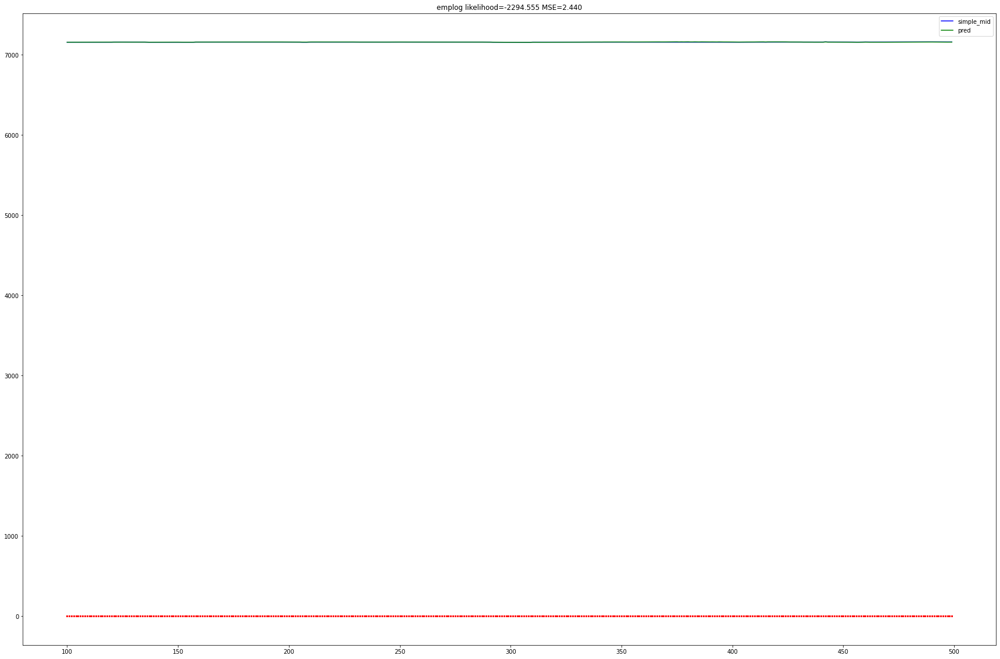

In [3]:
## Unsmoothed
df= pd.read_csv("data/ftx_book_snapshot_25_2020-01-01_BTC-PERP.csv.gz")
df['simple_mid'] = 0.5*(df['bids[0].price']+df['asks[0].price'])
a = -2
b = -1

n_particle = 100
alpha_2 = 1 #10**b
sigma_2 = 0.5
pf=ParticleFilter(df.simple_mid.values[1000:1500], n_particle,sigma_2, alpha_2)
pf.simulate(roll_window=100, method='emp', smoother=None)
pf.draw_graph(lagged_weight=0)

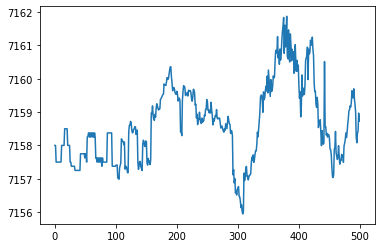

In [4]:
plt.plot(pf.x_mean)

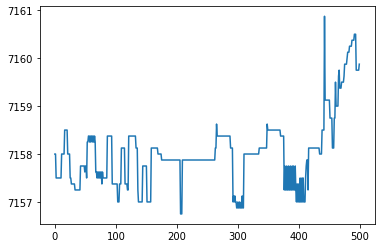

In [14]:
plt.plot(pf.y)

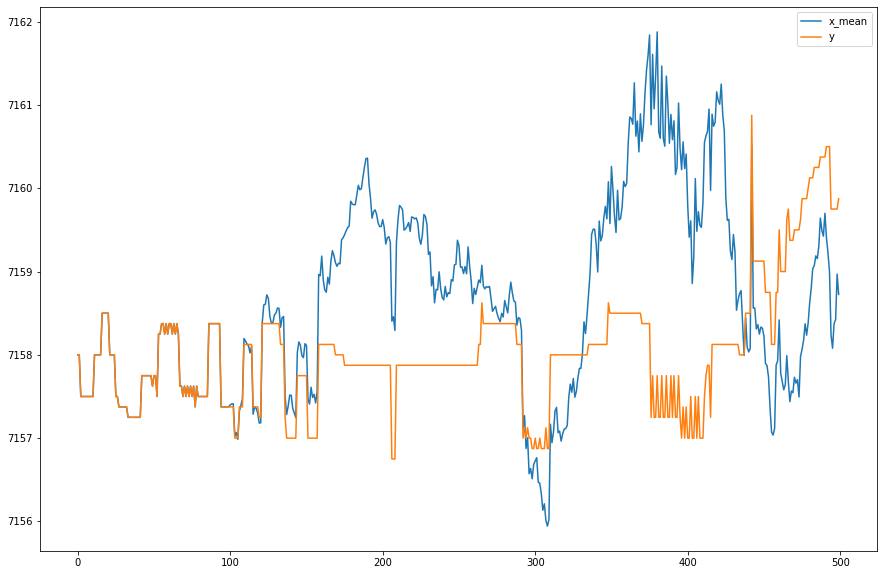

In [17]:
fig, ax = plt.subplots(figsize=(15,10))
ax.plot(pf.x_mean, label='x_mean')
ax.plot(pf.y, label='y')
plt.legend()


In [12]:
pf.x.shape

(501, 100)

In [34]:
class ParticleFilterPriceDiff(object):
    def __init__(self, y, n_particle, sigma_2, alpha_2):
        self.y = y
        self.n_particle = n_particle
        self.sigma_2 = sigma_2
        self.alpha_2 = alpha_2
        self.log_likelihood = -np.inf

    def norm_likelihood(self, y, x, s2):
        return (np.sqrt(2 * np.pi * s2)) ** (-1) * np.exp(-(y - x) ** 2 / (2 * s2))

    def F_inv(self, w_cumsum, idx, u):
        # print(f"u: {u}")
        if np.any(w_cumsum < u) == False:
            return 0
        k = np.max(idx[w_cumsum < u])
        return k + 1

    def resampling(self, weights):
        '''
        generate x_resampled[t+1] = x[t+1, k]

        '''
        w_cumsum = np.cumsum(weights)
        idx = np.asanyarray(range(self.n_particle))
        # print(f"idx shape: {idx.shape}")
        k_list = np.zeros(self.n_particle, dtype=np.int32)  # サンプリングしたkのリスト格納場所

        # 一様分布から重みに応じてリサンプリングする添え字を取得
        for i, u in enumerate(rd.uniform(0, 1, size=self.n_particle)):
            k = self.F_inv(w_cumsum, idx, u)
            k_list[i] = k
        return k_list

    def resampling2(self, weights):
        """
        計算量の少ない層化サンプリング
        """
        idx = np.asanyarray(range(self.n_particle))

        u0 = rd.uniform(0, 1 / self.n_particle)
        u = [1 / self.n_particle * i + u0 for i in range(self.n_particle)]
        w_cumsum = np.cumsum(weights)
        k = np.asanyarray([self.F_inv(w_cumsum, idx, val) for val in u])
        return k

    def gen_price_diff_dist(self, t):
        ## changed to px returns
        self.price_diff_dist = np.asarray(
            np.unique(np.diff(self.y, 1)[t - self.roll_window:t],
                      return_counts=True)).T

        self.price_diff_dist[:, 1] = self.price_diff_dist[:, 1] / self.price_diff_dist[:, 1].sum()
        # self.price_diff_dist = pd.DataFrame(self.price_diff_dist, columns=['price_diff', 'likelihood'])

    def likelihood_price_dist_lookup(self, y, x):

        ## shift price diff dist by particle price (x) to get price dist of x
        p_dist = copy.deepcopy(self.price_diff_dist)
        p_dist[:, 0] = p_dist[:, 0] + x

        # print(f"y: {y} p_dist[:,0]: {p_dist[:,0]}")
        idx_likelihood = np.searchsorted(p_dist[:, 0], y, side='left')

        try:

            return p_dist[idx_likelihood, 1]
        except:
            return p_dist[idx_likelihood - 1, 1]

    def gen_v(self):
        return np.random.choice(self.price_diff_dist[:, 0], size=1, p=self.price_diff_dist[:, 1])[0]

    def neff(self, weights):
        '''
        calculate “effective sample size (ESS)"
        '''
        return 1. / np.sum(np.square(weights))

    def get_x_dist(self, x, t):

        x_dist = np.asarray(np.unique(x[t, :], return_counts=True)).T
        # print("calc x_dist")
        # print(x_dist)
        x_dist[:, 1] = x_dist[:, 1] / x_dist[:, 1].sum()
        return x_dist

    def backward_smoother(self, w_normed, x, t):

        ## x[t+1, :] is the current particles
        ## w_normed[t] is the current normalised weight
        ## x[t, :] is the previous particles
        ## w_normed[t-1] is the previous normalised weight

        # print(f"prev_x_dist: {prev_x_dist}")

        # w_smoother = np.zeros( self.n_particle)

        denoms = np.zeros(self.n_particle)
        for j in range(self.n_particle):
            # print(f"x[t+1, j]: {x[t+1, j]}")

            for k in range(self.n_particle):
                #                 print(f"w_normed[t-1,k]: {w_normed[t-1,k]}")
                #                 print(f"prev_x_dist: {prev_x_dist}")
                #                 print(f"self.likelihood_price_dist_lookup(prev_x_dist, x[t+1, j]): {self.likelihood_price_dist_lookup(prev_x_dist, x[t+1, j])}")
                denoms[j] += w_normed[t - 1, k] * self.likelihood_price_dist_lookup(x[t + 1, j], x[t, k])

            # denoms[j] = sum([w_normed[t-1,k] * self.likelihood_price_dist_lookup(prev_x_dist, x[t+1, j]) for k in range(self.n_particle)])

        for i in range(self.n_particle):
            # print(f"i: {i}")
            p_j = np.zeros(self.n_particle)
            for j in range(self.n_particle):
                p_j[j] = self.likelihood_price_dist_lookup(x[t + 1, j], x[t, i])

            # print(f"dim check {w_normed[t]} {p_j} {denoms}")
            sum_j = np.sum(w_normed[t] * p_j / denoms)
            w_normed[t, i] = w_normed[t - 1, i] * sum_j

        return w_normed

    def simulate(self, roll_window, method, smoother='fixed_lag', seed=71):

        self.roll_window = roll_window
        self.method = method
        rd.seed(seed)

        if smoother == 'fixed_lag':
            counter = 0

        # 時系列データ数
        T = len(self.y)

        # 潜在変数
        x = np.zeros((T + 1, self.n_particle))
        x_resampled = np.zeros((T + 1, self.n_particle))

        # 潜在変数の初期値
        # initial_x = rd.normal(0, 1, size=self.n_particle)

        initial_x = self.y[roll_window - 1]

        x[roll_window] = x_resampled[roll_window] = initial_x
        

        # 重み
        w = np.zeros((T, self.n_particle))
        w_normed = np.zeros((T, self.n_particle))

        l = np.zeros(T)  # 時刻毎の尤度

        for t in range(T):
            print(f"t:{t}")
            if t < self.roll_window:
                pass


            else:
                # print("\r calculating... t={}".format(t), end="")

                self.gen_price_diff_dist(t)

                print(f"px diff dist: {self.price_diff_dist}")

                # print(f"v dist: {np.average(self.price_diff_dist['price_diff'],weights=self.price_diff_dist['likelihood']) }")

                for i in range(self.n_particle):

                    # 1階差分トレンドを適用

                    ## draw sample noise from rolling window
                    # v = rd.normal(0, np.sqrt(self.alpha_2*self.sigma_2)) # System Noise

                    if method == 'emp':
                        v = self.gen_v()
                        print(f"v: {v}")
                        print(f"x_resampled[t, i]: {x_resampled[t, i]}")
                        x[t + 1, i] = x_resampled[t, i] + v  # システムノイズの付加
                        print(f"x[t + 1, i]: {x[t + 1, i]}")
                        w[t, i] = self.likelihood_price_dist_lookup(self.y[t], x[t + 1, i])
                    elif method == 'normal':
                        v = rd.normal(0, np.sqrt(self.alpha_2 * self.sigma_2))  # System Noise
                        x[t + 1, i] = x_resampled[t, i] + v  # システムノイズの付加
                        w[t, i] = self.norm_likelihood(self.y[t], x[t + 1, i],
                                                       self.sigma_2)  # y[t]Likelihood of each particle with respect to
                print("x")
                print(x[t+1])
                print("w")
                print(w[t])
                w_normed[t] = w[t] / np.sum(w[t])  # 規格化

                _unsmoothed_w_normed_t = copy.deepcopy(w_normed[t])

                l[t] = np.log(np.sum(w[t]))  # 各時刻対数尤度

                #                 print('w_normed')
                #                 print(w_normed)

                ##Smoother

                if smoother:
                    if smoother == 'fixed_lag':
                        if counter == 0:
                            k = self.resampling(w_normed[t])  # リサンプルで取得した粒子の添字
                            x_resampled[t + 1] = x[t + 1, k]
                            counter += 1
                        else:
                            x_resampled[t + 1] = x[t + 1, :]
                            counter -= 1

                    if smoother == 'backward':
                        if t != self.roll_window:
                            w_normed = self.backward_smoother(w_normed, x, t)
                            w_normed[t] = w_normed[t] / np.sum(w_normed[t])

                        k = self.resampling(w_normed[t])
                        x_resampled[t + 1] = x[t + 1, k]

                    if smoother == 'ess':
                        if self.neff(w_normed[t]) < self.n_particle / 2:
                            k = self.resampling(w_normed[t])  # リサンプルで取得した粒子の添字
                            x_resampled[t + 1] = x[t + 1, k]
                        else:
                            x_resampled[t + 1] = x[t + 1, :]


                else:
                    k = self.resampling(w_normed[t])
                    x_resampled[t + 1] = x[t + 1, k]

                # 全体の対数尤度
                self.log_likelihood = np.sum(l) - T * np.log(self.n_particle)

                self.x = x
                self.x_resampled = x_resampled
                self.w = w
                self.w_normed = w_normed
                self.l = l

    def get_filtered_value(self, lagged_weight):
        """
        尤度の重みで加重平均した値でフィルタリングされ値を算出
        """
        shifted_n = 1
        ## these are px returns
        x_mean = np.diag(np.dot(self.w_normed, self.x[1:].T))
        # x_mean = self.y *(x_mean+1)
        
        self.x_mean = x_mean

        shifted_x_mean = np.roll(self.x_mean, shifted_n)
        shifted_x_mean[:shifted_n] = self.x_mean[:shifted_n]
        shifted_x_mean[self.roll_window] = self.x_mean[self.roll_window]

        return (1 - lagged_weight) * x_mean + lagged_weight * shifted_x_mean

    def draw_graph(self, lagged_weight=0):
        # グラフ描画
        T = len(self.y)

        t_x = np.arange(self.roll_window, T)
        plt.figure(figsize=(30, 20))
        plt.plot(t_x, self.y[self.roll_window:], c="b", label="simple_mid")
        x_mean = self.get_filtered_value(lagged_weight)[self.roll_window:]
        plt.plot(t_x, x_mean, c="g", label="pred")

        for t in t_x:
            plt.scatter(np.ones(self.n_particle) * t, self.x[t], color="r", s=2, alpha=0.1)

        plt.legend()

        mse = np.mean((self.y[self.roll_window:] - x_mean) ** 2)
        plt.title(self.method + "log likelihood={:.3f}".format(self.log_likelihood) + " MSE={:.3f}".format(mse))
        plt.show()

t:0
t:1
t:2
t:3
t:4
t:5
t:6
t:7
t:8
t:9
t:10
t:11
t:12
t:13
t:14
t:15
t:16
t:17
t:18
t:19
t:20
t:21
t:22
t:23
t:24
t:25
t:26
t:27
t:28
t:29
t:30
t:31
t:32
t:33
t:34
t:35
t:36
t:37
t:38
t:39
t:40
t:41
t:42
t:43
t:44
t:45
t:46
t:47
t:48
t:49
t:50
t:51
t:52
t:53
t:54
t:55
t:56
t:57
t:58
t:59
t:60
t:61
t:62
t:63
t:64
t:65
t:66
t:67
t:68
t:69
t:70
t:71
t:72
t:73
t:74
t:75
t:76
t:77
t:78
t:79
t:80
t:81
t:82
t:83
t:84
t:85
t:86
t:87
t:88
t:89
t:90
t:91
t:92
t:93
t:94
t:95
t:96
t:97
t:98
t:99
t:100
px diff dist: [[-1.     0.01 ]
 [-0.625  0.01 ]
 [-0.5    0.03 ]
 [-0.25   0.02 ]
 [-0.125  0.13 ]
 [ 0.     0.64 ]
 [ 0.125  0.1  ]
 [ 0.25   0.01 ]
 [ 0.5    0.03 ]
 [ 0.75   0.01 ]
 [ 0.875  0.01 ]]
v: -0.125
x_resampled[t, i]: 7157.375
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.375
x[t + 1, i]: 7157.375
v: 0.0
x_resampled[t, i]: 7157.375
x[t + 1, i]: 7157.375
v: -0.125
x_resampled[t, i]: 7157.375
x[t + 1, i]: 7157.25
v: 0.125
x_resampled[t, i]: 7157.375
x[t + 1, i]: 7157.5
v: 0.0
x_resa

v: -0.25
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7156.75
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: -0.125
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.25
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.75
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7159.125
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.375
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.75
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.125
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7157.12

px diff dist: [[-1.     0.01 ]
 [-0.875  0.01 ]
 [-0.75   0.01 ]
 [-0.625  0.01 ]
 [-0.375  0.01 ]
 [-0.25   0.04 ]
 [-0.125  0.12 ]
 [ 0.     0.62 ]
 [ 0.125  0.1  ]
 [ 0.25   0.01 ]
 [ 0.375  0.01 ]
 [ 0.75   0.03 ]
 [ 0.875  0.01 ]
 [ 1.125  0.01 ]]
v: 0.125
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.125
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7156.0
x[t + 1, i]: 7156.0
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: -0.375
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7156.625
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: -0.125
x_resampled[t, i]: 7157.75
x[t + 1, i]: 7157.625
v: -0.75
x_resampled[t, i]: 7157.125
x[t + 1, i]: 7156.375
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 1.125
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.125
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.25
v: 0.0
x_resampled[t, i]

v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.75
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.875
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: -1.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7157.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 715

v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.75
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7158.625
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: -0.375
x_resampled[t, i]: 7

v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: -0.25
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.625
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 715

v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.75
x[t + 1, i]: 7157.75
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.87

v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.25
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157.875
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7157

v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.375
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.

v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: -0.25
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.625
v: -0.25
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.625
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: -0.125
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.75
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: -0.125
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.75
v: -0.125
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.75
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7156.875
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t,

v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.125
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: -0.125
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7157.875
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.0
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.0


v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.25
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.75
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.125
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.625
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: -0.125
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.375
v: 0.0
x_resampled[t, i]: 7158.5
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.5
x[

v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.125
x[t + 1, i]: 7157.125
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.25
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.5
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.125
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.375
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: -1.125
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7156.125
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v: 0.5
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.75
v: 0.0
x_resampled[t, i]: 7157.25
x[t + 1, i]: 7157.25
v

v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: -0.5
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7156.5
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: -1.125
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7155.875
v: -0.125
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7156.875
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.0
x_resampled[t, i]: 7157.0
x[t + 1, i]: 7157.0
v: 0.125
x_resampled[t, i]: 7157.0


v: -0.5
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7157.625
v: 0.5
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.625
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.5
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.625
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.375
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.5
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.5
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.625
v: -0.5
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7157.625
v: -0.125
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.0
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 7158.125
x[t + 1, i]: 7158.125
v: 0.0
x_resampled[t, i]: 71

v: 0.5
x_resampled[t, i]: 7159.625
x[t + 1, i]: 7160.125
v: 0.5
x_resampled[t, i]: 7159.125
x[t + 1, i]: 7159.625
v: 0.0
x_resampled[t, i]: 7159.125
x[t + 1, i]: 7159.125
x
[7159.125 7159.125 7158.625 7158.375 7159.125 7159.125 7159.125 7159.625
 7159.125 7159.125 7159.125 7159.    7161.5   7159.125 7158.625 7159.625
 7159.125 7158.625 7159.625 7159.125 7159.125 7159.625 7159.125 7159.125
 7158.75  7161.5   7159.    7159.125 7159.125 7158.625 7159.125 7159.125
 7159.625 7158.625 7159.    7159.625 7159.125 7159.125 7158.75  7159.625
 7159.125 7159.125 7159.625 7159.625 7159.125 7159.125 7159.125 7159.125
 7159.125 7159.125 7159.    7157.375 7159.125 7158.625 7159.125 7158.625
 7159.625 7159.125 7158.625 7159.125 7159.    7158.625 7158.625 7159.625
 7159.625 7159.125 7159.125 7159.125 7159.625 7159.125 7159.625 7158.875
 7159.125 7159.125 7158.625 7159.125 7158.75  7159.125 7159.125 7159.5
 7159.625 7159.125 7159.125 7159.125 7159.125 7159.125 7159.125 7159.125
 7159.625 7159.125 7158.62

v: -0.5
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.0
v: 0.125
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.625
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.5
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7160.0
v: -0.375
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.125
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.5
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7160.0
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: -1.75
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7157.75
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: -0.375
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.125
v: 0.5
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7160.0
v: 0.5
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7160.0
v: 0.0
x_resampled[t, i]: 7159.5
x[t + 1, i]: 7159.5
v: 0.0
x_resampled[t, i]: 71

v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: 0.125
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.875
v: 0.125
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.875
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: 0.5
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7160.25
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: 0.25
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7160.0
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: -0.375
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.375
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: -0.375
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.375
v: 0.125
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.875
v: -0.5
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.25
v: 0.0
x_resampled[t, i]: 7159.75
x[t + 1, i]: 7159.75
v: -0.625
x_resampled[t, i]: 7159.75
x[t + 1, i

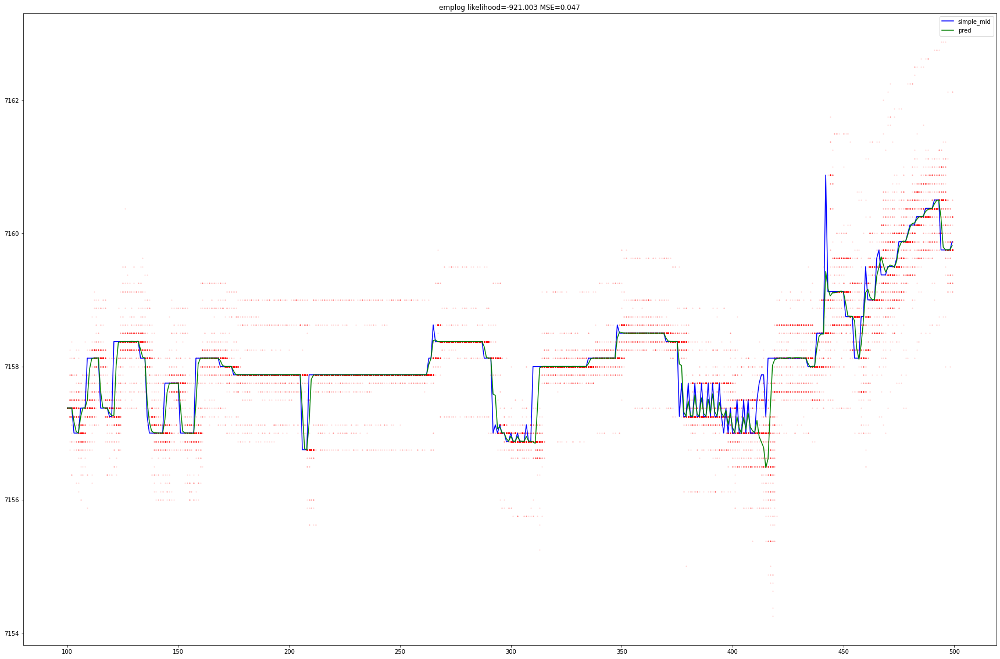

In [23]:
## Unsmoothed

n_particle = 100
alpha_2 = 1 #10**b
sigma_2 = 0.5
pf_px_diff=ParticleFilterPriceDiff(df.simple_mid.values[1000:1500], n_particle,sigma_2, alpha_2)
pf_px_diff.simulate(roll_window=100, method='emp', smoother=None)
pf_px_diff.draw_graph(lagged_weight=0)

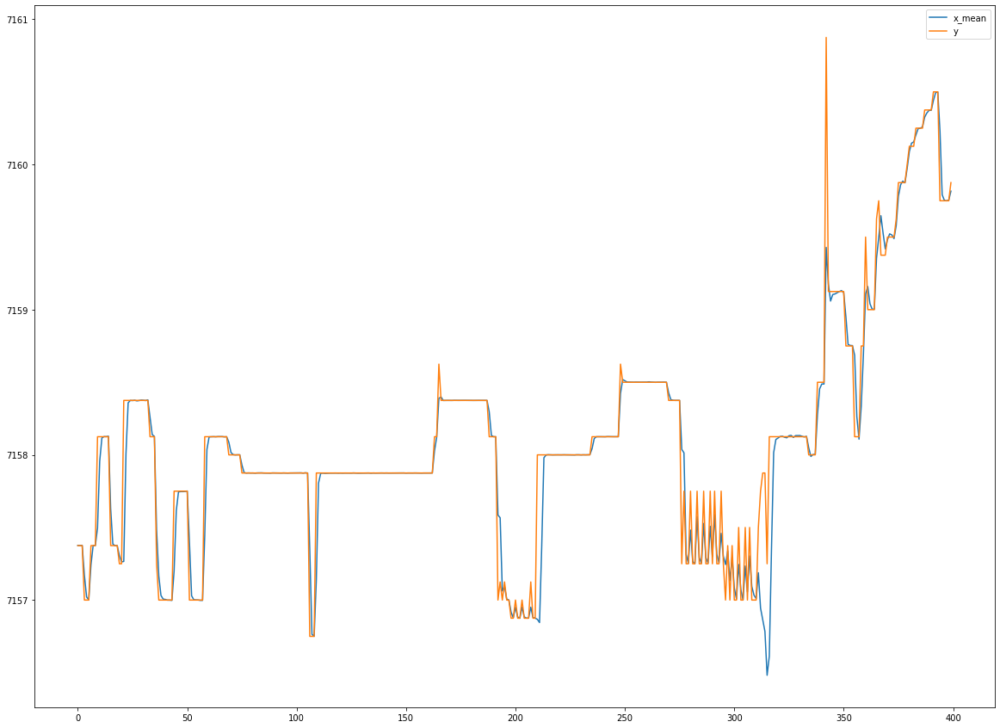

In [27]:
fig, ax = plt.subplots(figsize=(20,15))
ax.plot(pf_px_diff.x_mean[100:], label='x_mean')
ax.plot(pf_px_diff.y[100:], label='y')
plt.legend()


In [28]:
df_eurusd = pd.read_csv("GBPUSD-2022-11.zip",
                 names=['ticker', 'timestamp', 'bid','ask'],
                 nrows=50000)

df_eurusd['mid'] = 0.5*(df_eurusd['ask']+df_eurusd['bid'])


<AxesSubplot:>

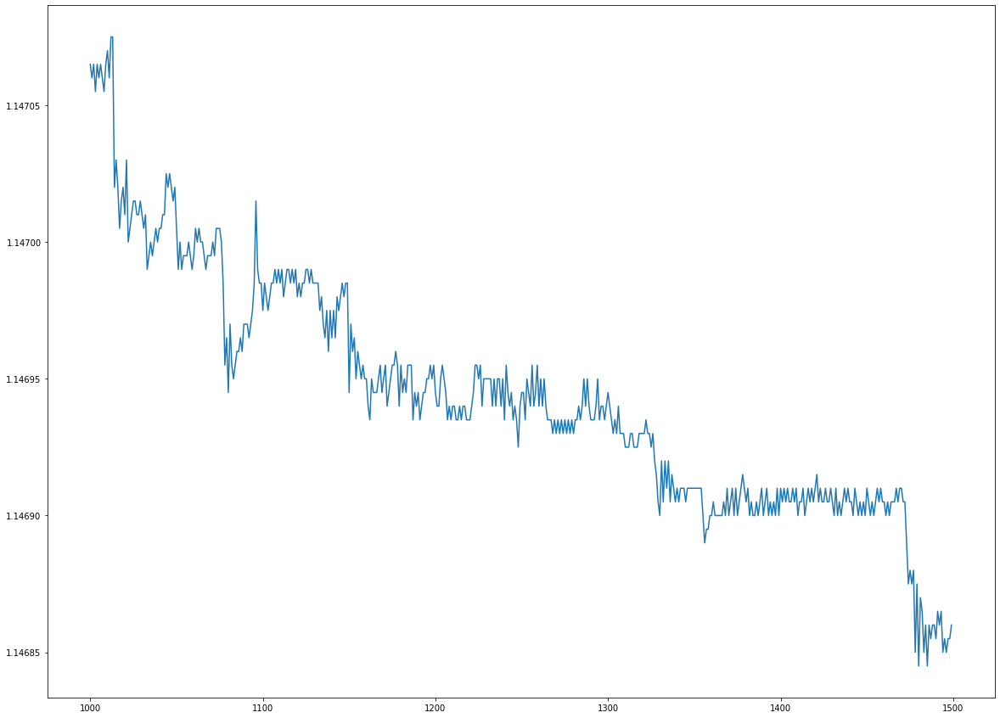

In [32]:
df_eurusd.mid[1000:1500].plot(figsize=(20,15))

t:0
t:1
t:2
t:3
t:4
t:5
t:6
t:7
t:8
t:9
t:10
t:11
t:12
t:13
t:14
t:15
t:16
t:17
t:18
t:19
t:20
t:21
t:22
t:23
t:24
t:25
t:26
t:27
t:28
t:29
t:30
t:31
t:32
t:33
t:34
t:35
t:36
t:37
t:38
t:39
t:40
t:41
t:42
t:43
t:44
t:45
t:46
t:47
t:48
t:49
t:50
t:51
t:52
t:53
t:54
t:55
t:56
t:57
t:58
t:59
t:60
t:61
t:62
t:63
t:64
t:65
t:66
t:67
t:68
t:69
t:70
t:71
t:72
t:73
t:74
t:75
t:76
t:77
t:78
t:79
t:80
t:81
t:82
t:83
t:84
t:85
t:86
t:87
t:88
t:89
t:90
t:91
t:92
t:93
t:94
t:95
t:96
t:97
t:98
t:99
t:100
px diff dist: [[-5.50000000e-05  1.00000000e-02]
 [-3.00000000e-05  1.00000000e-02]
 [-3.00000000e-05  1.00000000e-02]
 [-2.50000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.50000000e-05  2.00000000e-02]
 [-1.00000000e-05  4.00000000e-02]
 [-1.00000000e-05  2.00000000e-02]
 [-5.00000000e-06  2.00000000e-02]
 [-5.00000000e-06  1.90000000e-01]
 [-5.00000000e-06  3.00000000e-02]
 [-2.22044605e-16  1.00000000e-02]


t:123
px diff dist: [[-3.00000000e-05  1.00000000e-02]
 [-2.50000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.50000000e-05  1.00000000e-02]
 [-1.00000000e-05  4.00000000e-02]
 [-5.00000000e-06  5.00000000e-02]
 [-5.00000000e-06  1.70000000e-01]
 [-5.00000000e-06  5.00000000e-02]
 [-2.22044605e-16  2.00000000e-02]
 [ 0.00000000e+00  1.50000000e-01]
 [ 5.00000000e-06  9.00000000e-02]
 [ 5.00000000e-06  1.70000000e-01]
 [ 5.00000000e-06  8.00000000e-02]
 [ 1.00000000e-05  2.00000000e-02]
 [ 1.00000000e-05  5.00000000e-02]
 [ 1.50000000e-05  1.00000000e-02]
 [ 2.50000000e-05  1.00000000e-02]
 [ 3.00000000e-05  1.00000000e-02]]
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469850000000001
x[t + 1, i]: 1.146995
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469799999999999
x[t + 1, i]: 1.1469849999999997
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14699
x[t + 1, i]: 1.146995
v: 0.0
x_resampled[t, i]:

v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469749999999996
x[t + 1, i]: 1.1469699999999996
v: -2.220446049250313e-16
x_resampled[t, i]: 1.146975
x[t + 1, i]: 1.1469749999999999
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469850000000001
x[t + 1, i]: 1.1469900000000002
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146975
x[t + 1, i]: 1.14697
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469799999999997
x[t + 1, i]: 1.1469749999999996
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469850000000001
x[t + 1, i]: 1.14699
v: -4.999999999810711e-06
x_resampled[t, i]: 1.146975
x[t + 1, i]: 1.1469700000000003
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469649999999996
x[t + 1, i]: 1.1469599999999998
v: 3.0000000000196536e-05
x_resampled[t, i]: 1.1469850000000001
x[t + 1, i]: 1.1470150000000003
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146975
x[t + 1, i]: 1.14698
v: 0.0
x_resampled[t, i]: 1.1469799999999997
x[t + 1, i]: 1.1469799999999997
v: -4.999999999810711e-06
x_resampled[t

v: -1.999999999990898e-05
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.1469300000000002
v: 0.0
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.1469500000000001
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.14694
v: 9.999999999843467e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.146955
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.14694
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146930000000001
x[t + 1, i]: 1.146935000000001
v: 0.0
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.146945
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.1469550000000004
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.146945
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469399999999998
x[t + 1, i]: 1.146945
v: -9.999999999843467e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.1469350000000003
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.1469500000

v: 2.220446049250313e-16
x_resampled[t, i]: 1.1469299999999996
x[t + 1, i]: 1.1469299999999998
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469500000000006
x[t + 1, i]: 1.1469550000000004
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469300000000002
x[t + 1, i]: 1.1469350000000005
v: 0.0
x_resampled[t, i]: 1.1469499999999997
x[t + 1, i]: 1.1469499999999997
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469500000000004
x[t + 1, i]: 1.1469550000000006
v: 5.000000000254801e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.1469400000000003
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.1469399999999998
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469499999999995
x[t + 1, i]: 1.1469549999999997
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469499999999995
x[t + 1, i]: 1.1469599999999993
v: -2.500000000016378e-05
x_resampled[t, i]: 1.1469500000000004
x[t + 1, i]: 1.1469250000000002
v: 0.0
x_resampled[t, i]: 1.1469549999999995
x[t + 1, i]: 1.1469549999999995
v: 1.4999

px diff dist: [[-4.00000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-1.50000000e-05  1.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.00000000e-05  6.00000000e-02]
 [-1.00000000e-05  6.00000000e-02]
 [-5.00000000e-06  4.00000000e-02]
 [-5.00000000e-06  1.20000000e-01]
 [-5.00000000e-06  6.00000000e-02]
 [-2.22044605e-16  4.00000000e-02]
 [ 0.00000000e+00  1.00000000e-01]
 [ 2.22044605e-16  3.00000000e-02]
 [ 5.00000000e-06  1.20000000e-01]
 [ 5.00000000e-06  1.20000000e-01]
 [ 5.00000000e-06  8.00000000e-02]
 [ 1.00000000e-05  4.00000000e-02]
 [ 1.00000000e-05  2.00000000e-02]
 [ 1.50000000e-05  3.00000000e-02]
 [ 1.50000000e-05  1.00000000e-02]
 [ 2.50000000e-05  1.00000000e-02]]
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469399999999992
x[t + 1, i]: 1.146949999999999
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1469449999999994
x[t + 1, i]: 1.1469549999999995
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469549999999993
x[t + 1, i]: 1.1469499999999992

v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469399999999992
x[t + 1, i]: 1.146944999999999
v: -4.999999999810711e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.146945
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146955
x[t + 1, i]: 1.14696
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469549999999997
x[t + 1, i]: 1.1469449999999997
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.146955
v: -9.999999999843467e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.1469250000000002
v: -9.999999999843467e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.14694
v: -9.999999999843467e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.14694
v: 2.220446049250313e-16
x_resampled[t, i]: 1.1469649999999998
x[t + 1, i]: 1.146965
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469449999999997
x[t + 1, i]: 1.1469399999999996
v: 0.0
x_resampled[t, i]: 1.1469549999999997
x[t + 1, i]: 1.1469549999999997
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146955
x[t + 1, i]: 1.14695
v: 5.00000000003275

v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.1469550000000002
v: 1.4999999999876223e-05
x_resampled[t, i]: 1.1469299999999996
x[t + 1, i]: 1.1469449999999994
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14693
x[t + 1, i]: 1.146935
v: 9.999999999843467e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.146955
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469349999999998
x[t + 1, i]: 1.1469249999999998
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469399999999998
x[t + 1, i]: 1.146945
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469349999999998
x[t + 1, i]: 1.1469449999999997
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469449999999999
x[t + 1, i]: 1.14694
v: -9.999999999843467e-06
x_resampled[t, i]: 1.1469350000000003
x[t + 1, i]: 1.1469250000000004
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469449999999999
x[t + 1, i]: 1.1469399999999998
v: 1.4999999999876223e-05
x_resampled[t, i]: 1.1469350000000005
x[t + 1, i]: 1.1469500000000004
v: 5.00000

v: -1.5000000000320313e-05
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.1469199999999997
v: 0.0
x_resampled[t, i]: 1.1469450000000003
x[t + 1, i]: 1.1469450000000003
x
[1.146945 1.14695  1.14694  1.14696  1.14692  1.14692  1.14695  1.146935
 1.146925 1.14695  1.14692  1.146955 1.14692  1.146945 1.14694  1.146925
 1.14692  1.14692  1.146935 1.14691  1.14693  1.14695  1.146925 1.146925
 1.146935 1.14694  1.14696  1.14693  1.14694  1.146925 1.146935 1.146935
 1.14691  1.14693  1.14695  1.146945 1.146935 1.146935 1.146945 1.14694
 1.14695  1.14695  1.14693  1.146895 1.14692  1.146945 1.146925 1.146925
 1.14695  1.14692  1.14693  1.14695  1.14694  1.14693  1.146915 1.146925
 1.146935 1.146945 1.14693  1.146925 1.14695  1.14693  1.146935 1.146925
 1.146925 1.14693  1.146925 1.14695  1.14694  1.146925 1.146925 1.146925
 1.146925 1.14693  1.14691  1.146925 1.14692  1.14693  1.14693  1.14693
 1.146925 1.146925 1.146925 1.14696  1.146925 1.14693  1.14694  1.14695
 1.146935 1.14693  1.146945 1.1469

t:301
px diff dist: [[-1.50000000e-05  2.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.00000000e-05  8.00000000e-02]
 [-1.00000000e-05  4.00000000e-02]
 [-5.00000000e-06  3.00000000e-02]
 [-5.00000000e-06  1.40000000e-01]
 [-5.00000000e-06  6.00000000e-02]
 [-2.22044605e-16  1.00000000e-02]
 [ 0.00000000e+00  1.60000000e-01]
 [ 2.22044605e-16  2.00000000e-02]
 [ 5.00000000e-06  4.00000000e-02]
 [ 5.00000000e-06  1.80000000e-01]
 [ 5.00000000e-06  3.00000000e-02]
 [ 1.00000000e-05  6.00000000e-02]
 [ 1.00000000e-05  6.00000000e-02]
 [ 1.50000000e-05  2.00000000e-02]
 [ 1.50000000e-05  1.00000000e-02]
 [ 2.00000000e-05  1.00000000e-02]]
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.14694
v: 1.5000000000320313e-05
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.1469650000000005
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.146945
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.14693
v: -1.0000000000065512e-05
x_r

v: -5.000000000032756e-06
x_resampled[t, i]: 1.14693
x[t + 1, i]: 1.146925
v: -4.999999999810711e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.1469300000000002
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.14694
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469350000000003
x[t + 1, i]: 1.1469300000000002
v: 0.0
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.14694
v: -4.999999999810711e-06
x_resampled[t, i]: 1.14693
x[t + 1, i]: 1.1469250000000002
v: 0.0
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.1469500000000001
v: 0.0
x_resampled[t, i]: 1.1469350000000003
x[t + 1, i]: 1.1469350000000003
v: 0.0
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.146935
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469350000000003
x[t + 1, i]: 1.1469300000000002
v: -1.4999999999876223e-05
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.1469250000000002
v: 0.0
x_resampled[t, i]: 1.14693
x[t + 1, i]: 1.14693
v: 1.5000000000320313e-05
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.1469550000000

v: 1.0000000000065512e-05
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469
v: 5.000000000254801e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469100000000003
v: -4.999999999810711e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469050000000003
v: 0.0
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146895
x[t + 1, i]: 1.14689
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469049999999998
x[t + 1, i]: 1.1469099999999999
v: 5.000000000254801e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469100000000003
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469100000000003
v: 0.0
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.146905
v: 0.0
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146905
v: -5.000000000032756e-06
x_resam

v: 0.0
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146905
v: -5.000000000254801e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1468999999999998
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146895
v: -5.000000000254801e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1468999999999998
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1468949999999998
x[t + 1, i]: 1.1468899999999997
v: 0.0
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469050000000003
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1468999999999998
x[t + 1, i]: 1.1469049999999998
v: 0.0
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146905
v: -5.000000000254801e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1468999999999998
v: 0.0
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.1469
v: 0.0
x_resampled[t, i]: 1.1469049999999998
x[t + 1, i]: 1.1469049999999998
v: 0.0
x_resampled[t, i]: 1.1469099999999999
x[t + 1, i]: 1.1469099999999999
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469150

v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469100000000003
x[t + 1, i]: 1.1469150000000004
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1468900000000004
x[t + 1, i]: 1.1468950000000004
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469100000000008
x[t + 1, i]: 1.1469150000000006
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469100000000003
x[t + 1, i]: 1.1469150000000004
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146895
v: -9.999999999843467e-06
x_resampled[t, i]: 1.1469100000000003
x[t + 1, i]: 1.1469000000000005
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469200000000002
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469100000000003
x[t + 1, i]: 1.1469150000000004
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469100000000003
x[t + 1, i]: 1.1469150000

v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469099999999999
x[t + 1, i]: 1.1469199999999997
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1469099999999997
x[t + 1, i]: 1.1469199999999997
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469050000000014
x[t + 1, i]: 1.1469100000000012
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.1469
v: 2.0000000000131024e-05
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469250000000004
v: -5.000000000254801e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469049999999998
v: 0.0
x_resampled[t, i]: 1.1469100000000017
x[t + 1, i]: 1.1469100000000017
v: 0.0
x_resampled[t, i]: 1.1469050000000005
x[t + 1, i]: 1.1469050000000005
v: 0.0
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146905
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469300000000013
x[t + 1, i]: 1.1469350000000014
v: 0.0
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469050000000003
v: 4.999999999810711e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.14690999

v: 0.0
x_resampled[t, i]: 1.146925
x[t + 1, i]: 1.146925
v: 2.220446049250313e-16
x_resampled[t, i]: 1.1469099999999997
x[t + 1, i]: 1.1469099999999999
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1468949999999998
x[t + 1, i]: 1.14689
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469149999999995
x[t + 1, i]: 1.1469099999999994
v: -2.220446049250313e-16
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469099999999999
v: 0.0
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.1469
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1468949999999998
x[t + 1, i]: 1.1468899999999995
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469100000000003
x[t + 1, i]: 1.1469050000000005
v: 0.0
x_resampled[t, i]: 1.146905000000001
x[t + 1, i]: 1.146905000000001
v: 0.0
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.1469
v: 4.999999999810711e-06
x_resampled[t, i]: 1.146905000000001
x[t + 1, i]: 1.1469100000000008
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469049999999998
x[t + 1, i]: 1.1468949999999998
v: 0.0
x_resampled

v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1469949999999995
x[t + 1, i]: 1.1470049999999996
v: 4.999999999810711e-06
x_resampled[t, i]: 1.14697
x[t + 1, i]: 1.1469749999999999
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469550000000008
x[t + 1, i]: 1.1469600000000009
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469350000000005
x[t + 1, i]: 1.1469400000000005
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469249999999993
x[t + 1, i]: 1.146919999999999
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469749999999992
x[t + 1, i]: 1.146979999999999
v: -5.000000000254801e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.1469449999999997
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469350000000007
x[t + 1, i]: 1.146940000000001
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.146955
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146954999999999
x[t + 1, i]: 1.146959999999999
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469450000000008
x[t + 1, i]: 1.146935000000000

v: 5.000000000032756e-06
x_resampled[t, i]: 1.1468749999999999
x[t + 1, i]: 1.14688
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1468800000000003
x[t + 1, i]: 1.1468850000000002
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1468650000000002
x[t + 1, i]: 1.1468700000000003
v: 5.000000000254801e-06
x_resampled[t, i]: 1.146865000000001
x[t + 1, i]: 1.1468700000000012
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1468800000000008
x[t + 1, i]: 1.1468850000000006
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1468650000000005
x[t + 1, i]: 1.1468750000000005
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1468650000000002
x[t + 1, i]: 1.1468700000000005
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1468650000000005
x[t + 1, i]: 1.1468700000000005
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1468650000000005
x[t + 1, i]: 1.1468550000000004
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1468650000000002
x[t + 1, i]: 1.14686
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1468750000000005
x[t +

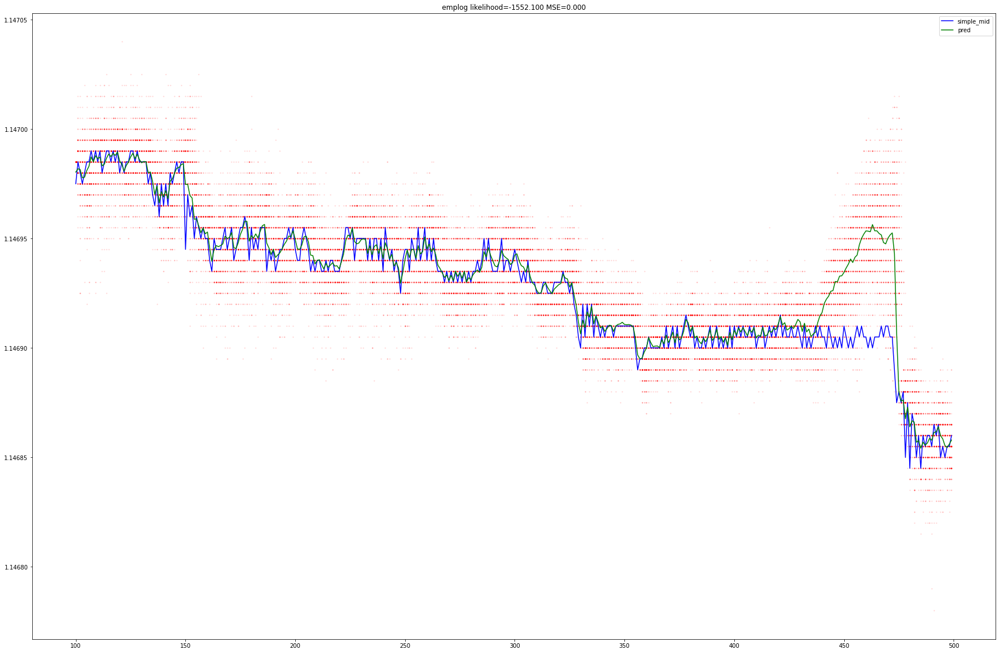

In [36]:
n_particle = 100
alpha_2 = 1 #10**b
sigma_2 = 0.5
pf_px_diff=ParticleFilterPriceDiff(df_eurusd.mid[1000:1500].values, n_particle,sigma_2, alpha_2)
pf_px_diff.simulate(roll_window=100, method='emp', smoother=None)
pf_px_diff.draw_graph(lagged_weight=0)

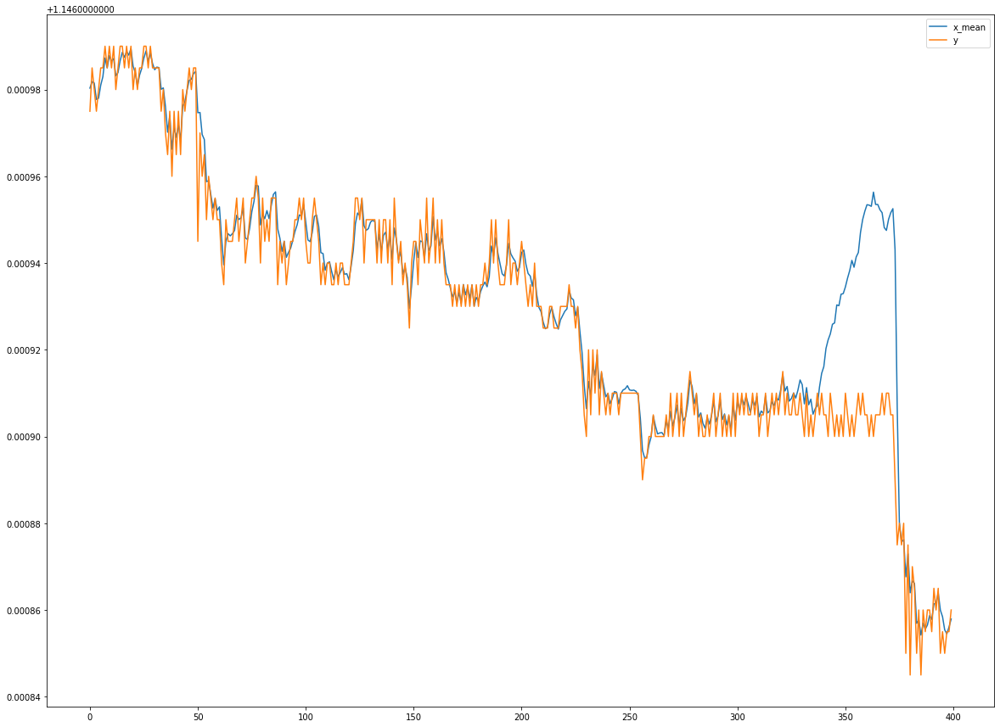

In [37]:
fig, ax = plt.subplots(figsize=(20,15))
ax.plot(pf_px_diff.x_mean[100:], label='x_mean')
ax.plot(pf_px_diff.y[100:], label='y')
plt.legend() 

t:0
t:1
t:2
t:3
t:4
t:5
t:6
t:7
t:8
t:9
t:10
t:11
t:12
t:13
t:14
t:15
t:16
t:17
t:18
t:19
t:20
t:21
t:22
t:23
t:24
t:25
t:26
t:27
t:28
t:29
t:30
t:31
t:32
t:33
t:34
t:35
t:36
t:37
t:38
t:39
t:40
t:41
t:42
t:43
t:44
t:45
t:46
t:47
t:48
t:49
t:50
t:51
t:52
t:53
t:54
t:55
t:56
t:57
t:58
t:59
t:60
t:61
t:62
t:63
t:64
t:65
t:66
t:67
t:68
t:69
t:70
t:71
t:72
t:73
t:74
t:75
t:76
t:77
t:78
t:79
t:80
t:81
t:82
t:83
t:84
t:85
t:86
t:87
t:88
t:89
t:90
t:91
t:92
t:93
t:94
t:95
t:96
t:97
t:98
t:99
t:100
px diff dist: [[-5.50000000e-05  1.00000000e-02]
 [-3.00000000e-05  1.00000000e-02]
 [-3.00000000e-05  1.00000000e-02]
 [-2.50000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.50000000e-05  2.00000000e-02]
 [-1.00000000e-05  4.00000000e-02]
 [-1.00000000e-05  2.00000000e-02]
 [-5.00000000e-06  2.00000000e-02]
 [-5.00000000e-06  1.90000000e-01]
 [-5.00000000e-06  3.00000000e-02]
 [-2.22044605e-16  1.00000000e-02]


px diff dist: [[-3.00000000e-05  1.00000000e-02]
 [-2.50000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-2.00000000e-05  1.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.50000000e-05  1.00000000e-02]
 [-1.00000000e-05  4.00000000e-02]
 [-5.00000000e-06  5.00000000e-02]
 [-5.00000000e-06  1.70000000e-01]
 [-5.00000000e-06  5.00000000e-02]
 [-2.22044605e-16  2.00000000e-02]
 [ 0.00000000e+00  1.60000000e-01]
 [ 5.00000000e-06  8.00000000e-02]
 [ 5.00000000e-06  1.70000000e-01]
 [ 5.00000000e-06  8.00000000e-02]
 [ 1.00000000e-05  2.00000000e-02]
 [ 1.00000000e-05  5.00000000e-02]
 [ 1.50000000e-05  1.00000000e-02]
 [ 2.50000000e-05  1.00000000e-02]
 [ 3.00000000e-05  1.00000000e-02]]
v: 4.999999999810711e-06
x_resampled[t, i]: 1.14698
x[t + 1, i]: 1.146985
v: 5.000000000254801e-06
x_resampled[t, i]: 1.146985
x[t + 1, i]: 1.1469900000000002
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469749999999999
x[t + 1, i]: 1.14698
v: 4.999999999810711e-06
x_resampled[t, i]

v: -5.000000000032756e-06
x_resampled[t, i]: 1.1470049999999998
x[t + 1, i]: 1.1469999999999998
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469799999999994
x[t + 1, i]: 1.1469899999999993
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469849999999997
x[t + 1, i]: 1.1469749999999996
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146990000000001
x[t + 1, i]: 1.146985000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469799999999997
x[t + 1, i]: 1.1469749999999996
v: 4.999999999810711e-06
x_resampled[t, i]: 1.14698
x[t + 1, i]: 1.146985
v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469599999999998
x[t + 1, i]: 1.1469699999999996
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469749999999999
x[t + 1, i]: 1.1469799999999997
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469749999999999
x[t + 1, i]: 1.1469699999999998
v: 9.999999999843467e-06
x_resampled[t, i]: 1.14698
x[t + 1, i]: 1.14699
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469900000000002
x[t + 1, i]: 1.14698
v: 

v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469600000000002
x[t + 1, i]: 1.1469650000000002
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469549999999997
x[t + 1, i]: 1.14696
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1469399999999998
x[t + 1, i]: 1.14695
v: 0.0
x_resampled[t, i]: 1.1469449999999999
x[t + 1, i]: 1.1469449999999999
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146975
x[t + 1, i]: 1.14697
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469500000000004
x[t + 1, i]: 1.1469550000000004
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469399999999998
x[t + 1, i]: 1.146945
v: 4.999999999810711e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.14695
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.14694
v: -2.9999999999752447e-05
x_resampled[t, i]: 1.1469499999999992
x[t + 1, i]: 1.1469199999999995
v: -2.220446049250313e-16
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.1469449999999999
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1469599999999989
x[t + 1,

v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469499999999997
x[t + 1, i]: 1.146955
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469700000000005
x[t + 1, i]: 1.1469750000000005
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469399999999998
x[t + 1, i]: 1.1469299999999998
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469400000000016
x[t + 1, i]: 1.1469450000000019
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469449999999994
x[t + 1, i]: 1.1469349999999994
v: -2.220446049250313e-16
x_resampled[t, i]: 1.1469599999999995
x[t + 1, i]: 1.1469599999999993
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469449999999997
x[t + 1, i]: 1.1469499999999997
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469400000000007
x[t + 1, i]: 1.1469450000000005
v: -9.999999999843467e-06
x_resampled[t, i]: 1.1469400000000007
x[t + 1, i]: 1.146930000000001
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469749999999999
x[t + 1, i]: 1.14698
v: 1.4999999999876223e-05
x_resampled[t, i]: 1.1469449999999997
x[

v: 4.999999999810711e-06
x_resampled[t, i]: 1.146965
x[t + 1, i]: 1.1469699999999998
v: 2.220446049250313e-16
x_resampled[t, i]: 1.1469649999999998
x[t + 1, i]: 1.146965
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469450000000028
x[t + 1, i]: 1.1469500000000026
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.146965000000001
x[t + 1, i]: 1.1469550000000008
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469500000000024
x[t + 1, i]: 1.1469450000000023
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469449999999994
x[t + 1, i]: 1.1469499999999995
v: 4.999999999810711e-06
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.1469549999999997
v: 0.0
x_resampled[t, i]: 1.1469500000000026
x[t + 1, i]: 1.1469500000000026
v: -5.000000000254801e-06
x_resampled[t, i]: 1.146955
x[t + 1, i]: 1.1469499999999997
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146955
x[t + 1, i]: 1.14696
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469500000000006
x[t + 1, i]: 1.1469550000000004
v: 2.220446049250313e-16
x_resam

v: 4.999999999810711e-06
x_resampled[t, i]: 1.146944999999999
x[t + 1, i]: 1.1469499999999988
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.146935
v: -9.999999999843467e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.1469250000000002
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469200000000008
x[t + 1, i]: 1.146925000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469500000000001
x[t + 1, i]: 1.146945
v: 2.220446049250313e-16
x_resampled[t, i]: 1.1469350000000005
x[t + 1, i]: 1.1469350000000007
v: -9.999999999843467e-06
x_resampled[t, i]: 1.1469500000000006
x[t + 1, i]: 1.1469400000000007
v: -1.4999999999876223e-05
x_resampled[t, i]: 1.1469400000000003
x[t + 1, i]: 1.1469250000000004
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469300000000002
x[t + 1, i]: 1.146935
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469449999999988
x[t + 1, i]: 1.1469399999999985
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469249999999998
x[t + 1, i]: 1.146919999999999

px diff dist: [[-2.00000000e-05  1.00000000e-02]
 [-1.50000000e-05  2.00000000e-02]
 [-1.50000000e-05  3.00000000e-02]
 [-1.00000000e-05  7.00000000e-02]
 [-1.00000000e-05  6.00000000e-02]
 [-5.00000000e-06  4.00000000e-02]
 [-5.00000000e-06  1.30000000e-01]
 [-5.00000000e-06  5.00000000e-02]
 [-2.22044605e-16  2.00000000e-02]
 [ 0.00000000e+00  1.40000000e-01]
 [ 2.22044605e-16  3.00000000e-02]
 [ 5.00000000e-06  3.00000000e-02]
 [ 5.00000000e-06  1.70000000e-01]
 [ 5.00000000e-06  4.00000000e-02]
 [ 1.00000000e-05  7.00000000e-02]
 [ 1.00000000e-05  4.00000000e-02]
 [ 1.50000000e-05  3.00000000e-02]
 [ 1.50000000e-05  1.00000000e-02]
 [ 2.00000000e-05  1.00000000e-02]]
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469399999999994
x[t + 1, i]: 1.1469349999999991
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469350000000005
x[t + 1, i]: 1.1469250000000004
v: 9.999999999843467e-06
x_resampled[t, i]:

v: -5.000000000032756e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.14694
v: -9.999999999843467e-06
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.1469300000000002
v: 0.0
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.146945
v: 0.0
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.14694
v: 0.0
x_resampled[t, i]: 1.14695
x[t + 1, i]: 1.14695
v: -9.999999999843467e-06
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.1469300000000002
v: -4.999999999810711e-06
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.1469400000000003
v: -1.4999999999876223e-05
x_resampled[t, i]: 1.1469550000000006
x[t + 1, i]: 1.1469400000000007
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469399999999998
x[t + 1, i]: 1.1469349999999998
v: 1.4999999999876223e-05
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.146955
v: -1.5000000000320313e-05
x_resampled[t, i]: 1.146945
x[t + 1, i]: 1.1469299999999998
v: 4.999999999810711e-06
x_resampled[t, i]: 1.14694
x[t + 1, i]: 1.1469449999999999
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469350000000005


v: 5.000000000032756e-06
x_resampled[t, i]: 1.146935
x[t + 1, i]: 1.14694
v: -5.000000000032756e-06
x_resampled[t, i]: 1.14692
x[t + 1, i]: 1.146915
v: 1.4999999999876223e-05
x_resampled[t, i]: 1.1469299999999993
x[t + 1, i]: 1.1469449999999992
v: 0.0
x_resampled[t, i]: 1.1469150000000004
x[t + 1, i]: 1.1469150000000004
v: 0.0
x_resampled[t, i]: 1.1469249999999998
x[t + 1, i]: 1.1469249999999998
v: 0.0
x_resampled[t, i]: 1.1469499999999997
x[t + 1, i]: 1.1469499999999997
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146925
x[t + 1, i]: 1.14693
v: 0.0
x_resampled[t, i]: 1.1469350000000003
x[t + 1, i]: 1.1469350000000003
v: 0.0
x_resampled[t, i]: 1.1469200000000004
x[t + 1, i]: 1.1469200000000004
v: 9.999999999843467e-06
x_resampled[t, i]: 1.14692
x[t + 1, i]: 1.1469299999999998
v: 4.999999999810711e-06
x_resampled[t, i]: 1.146905000000001
x[t + 1, i]: 1.1469100000000008
v: 0.0
x_resampled[t, i]: 1.14692
x[t + 1, i]: 1.14692
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469250000000004

v: 9.999999999843467e-06
x_resampled[t, i]: 1.1469150000000004
x[t + 1, i]: 1.1469250000000002
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1468950000000002
x[t + 1, i]: 1.1468850000000002
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469050000000005
x[t + 1, i]: 1.1469100000000005
v: 0.0
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146935000000001
x[t + 1, i]: 1.146930000000001
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469200000000002
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1469000000000005
x[t + 1, i]: 1.1469100000000005
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.14691
v: -4.999999999810711e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469050000000003
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469200000000002
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469099999999997
x[t + 1, i]: 1.1469149999999997
v: -1.499999

v: -1.0000000000065512e-05
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146895
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469050000000005
x[t + 1, i]: 1.1469000000000007
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469050000000005
x[t + 1, i]: 1.1468950000000004
v: 0.0
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469150000000001
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469150000000001
x[t + 1, i]: 1.1469200000000002
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469100000000003
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469200000000002
v: 0.0
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.1469
v: 0.0
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469050000000003
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469000000000003
x
[1.14691  1.146925 1.146915 1.14691  1.146905 1.146905 1.146915 1.14689
 1.146905 1.1469   1.14691  1.14689  1.146915 1.14692  1.146915 1.1469
 1.1469

v: -1.5000000000098268e-05
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.146885
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469150000000008
x[t + 1, i]: 1.146920000000001
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469000000000011
x[t + 1, i]: 1.146905000000001
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.1469049999999998
v: 0.0
x_resampled[t, i]: 1.1469050000000005
x[t + 1, i]: 1.1469050000000005
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146920000000001
x[t + 1, i]: 1.146925000000001
v: 0.0
x_resampled[t, i]: 1.146910000000001
x[t + 1, i]: 1.146910000000001
v: -9.999999999843467e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469000000000003
v: 0.0
x_resampled[t, i]: 1.1469000000000007
x[t + 1, i]: 1.1469000000000007
v: -9.999999999843467e-06
x_resampled[t, i]: 1.146925
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469150000000004
x[t + 1, i]: 1.1469100000000003
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469200000000008


v: 5.000000000032756e-06
x_resampled[t, i]: 1.1469200000000006
x[t + 1, i]: 1.1469250000000006
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469150000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469050000000012
x[t + 1, i]: 1.1469000000000011
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469200000000002
x[t + 1, i]: 1.1469150000000004
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469050000000012
x[t + 1, i]: 1.1469000000000011
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146930000000002
x[t + 1, i]: 1.146935000000002
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469
x[t + 1, i]: 1.14689
v: 5.000000000032756e-06
x_resampled[t, i]: 1.14691
x[t + 1, i]: 1.1469150000000001
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.146905
x[t + 1, i]: 1.146895
v: 5.000000000254801e-06
x_resampled[t, i]: 1.146915000000002
x[t + 1, i]: 1.1469200000000022
v: 0.0
x_resampled[t, i]: 1.1469050000000003
x[t + 1, i]: 1.1469050000000003
v: 4.999999999810711e-06
x_resampl

v: 4.999999999810711e-06
x_resampled[t, i]: 1.1469400000000007
x[t + 1, i]: 1.1469450000000005
v: 0.0
x_resampled[t, i]: 1.1469450000000008
x[t + 1, i]: 1.1469450000000008
v: 4.999999999810711e-06
x_resampled[t, i]: 1.146930000000002
x[t + 1, i]: 1.1469350000000018
v: 5.000000000254801e-06
x_resampled[t, i]: 1.1469449999999994
x[t + 1, i]: 1.1469499999999997
v: 0.0
x_resampled[t, i]: 1.146925000000001
x[t + 1, i]: 1.146925000000001
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469600000000013
x[t + 1, i]: 1.1469550000000013
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469400000000005
x[t + 1, i]: 1.1469350000000003
v: -1.0000000000065512e-05
x_resampled[t, i]: 1.1469199999999997
x[t + 1, i]: 1.1469099999999997
v: -5.000000000032756e-06
x_resampled[t, i]: 1.1469350000000011
x[t + 1, i]: 1.1469300000000011
v: -4.999999999810711e-06
x_resampled[t, i]: 1.146940000000002
x[t + 1, i]: 1.1469350000000023
v: 2.220446049250313e-16
x_resampled[t, i]: 1.146925000000002
x[t + 1, i]: 1.1469250

v: 4.999999999810711e-06
x_resampled[t, i]: 1.1470050000000005
x[t + 1, i]: 1.1470100000000003
v: -5.000000000032756e-06
x_resampled[t, i]: 1.146855000000003
x[t + 1, i]: 1.146850000000003
v: 5.000000000032756e-06
x_resampled[t, i]: 1.1468900000000015
x[t + 1, i]: 1.1468950000000016
v: -5.000000000254801e-06
x_resampled[t, i]: 1.1469749999999987
x[t + 1, i]: 1.1469699999999985
v: 5.000000000032756e-06
x_resampled[t, i]: 1.146925000000001
x[t + 1, i]: 1.1469300000000011
v: -4.999999999810711e-06
x_resampled[t, i]: 1.146925
x[t + 1, i]: 1.1469200000000002
v: 4.999999999810711e-06
x_resampled[t, i]: 1.146940000000001
x[t + 1, i]: 1.1469450000000008
v: 1.0000000000065512e-05
x_resampled[t, i]: 1.1468950000000024
x[t + 1, i]: 1.1469050000000025
v: -4.999999999810711e-06
x_resampled[t, i]: 1.1469250000000009
x[t + 1, i]: 1.146920000000001
v: -9.999999999843467e-06
x_resampled[t, i]: 1.1469299999999998
x[t + 1, i]: 1.14692
v: 4.999999999810711e-06
x_resampled[t, i]: 1.1468550000000022
x[t + 1

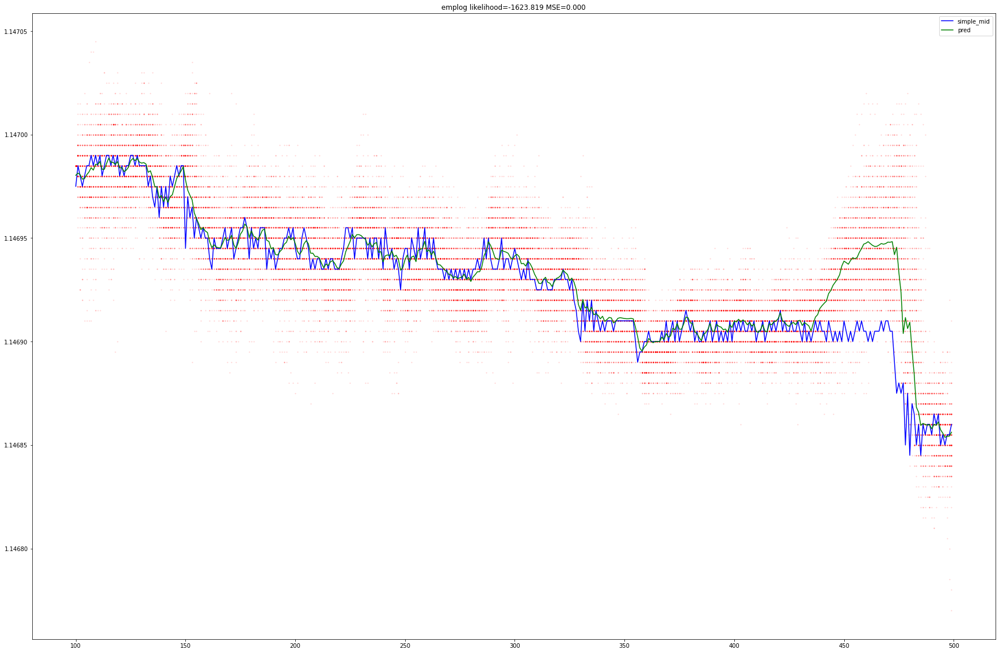

In [39]:
## Fixed Lag Smoothed
pf_px_diff.simulate(roll_window=100, method='emp', smoother='fixed_lag')
pf_px_diff.draw_graph(lagged_weight=0.3)

In [40]:
pf_px_diff.x

array([[0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       ...,
       [1.14684 , 1.14686 , 1.146855, ..., 1.14686 , 1.146855, 1.146825],
       [1.146835, 1.146865, 1.14685 , ..., 1.14685 , 1.146855, 1.14682 ],
       [1.14685 , 1.146855, 1.14682 , ..., 1.146855, 1.146865, 1.146765]])

In [43]:
pf_px_diff.w_normed[350,:]

array([0.00145985, 0.00145985, 0.00145985, 0.0350365 , 0.01021898,
       0.00583942, 0.00145985, 0.01021898, 0.00583942, 0.00437956,
       0.00291971, 0.00437956, 0.00145985, 0.00583942, 0.00145985,
       0.00437956, 0.00437956, 0.00437956, 0.01021898, 0.00583942,
       0.0350365 , 0.00437956, 0.00145985, 0.02481752, 0.00291971,
       0.02335766, 0.00291971, 0.00145985, 0.00437956, 0.00437956,
       0.00291971, 0.00583942, 0.00291971, 0.00291971, 0.01021898,
       0.0350365 , 0.02481752, 0.00145985, 0.00437956, 0.00583942,
       0.00291971, 0.0350365 , 0.00291971, 0.00145985, 0.00145985,
       0.00291971, 0.00291971, 0.00145985, 0.0350365 , 0.00291971,
       0.01021898, 0.00145985, 0.00291971, 0.00145985, 0.02481752,
       0.00291971, 0.00145985, 0.00291971, 0.0350365 , 0.00583942,
       0.00437956, 0.00145985, 0.01021898, 0.0350365 , 0.0350365 ,
       0.01021898, 0.00145985, 0.00145985, 0.01021898, 0.01021898,
       0.00291971, 0.00437956, 0.00437956, 0.00291971, 0.00145

In [44]:
pf_px_diff.x[350,:]

array([1.146895, 1.1469  , 1.146895, 1.146925, 1.14691 , 1.146925,
       1.1469  , 1.146905, 1.14692 , 1.1469  , 1.146925, 1.146915,
       1.1469  , 1.1469  , 1.146915, 1.14691 , 1.14691 , 1.14691 ,
       1.14691 , 1.14692 , 1.14691 , 1.146915, 1.146925, 1.146915,
       1.14694 , 1.14692 , 1.14691 , 1.146905, 1.146905, 1.146915,
       1.146945, 1.146915, 1.146935, 1.146925, 1.14691 , 1.14691 ,
       1.14691 , 1.14689 , 1.146915, 1.1469  , 1.146895, 1.146915,
       1.14693 , 1.146885, 1.1469  , 1.146925, 1.1469  , 1.146905,
       1.146925, 1.14693 , 1.146915, 1.1469  , 1.1469  , 1.146895,
       1.1469  , 1.146935, 1.14689 , 1.146915, 1.146905, 1.14692 ,
       1.1469  , 1.1469  , 1.146915, 1.146905, 1.146915, 1.146915,
       1.14689 , 1.14689 , 1.14691 , 1.146915, 1.146925, 1.14692 ,
       1.1469  , 1.146925, 1.1469  , 1.146905, 1.14691 , 1.14692 ,
       1.14689 , 1.14691 , 1.14693 , 1.1469  , 1.14692 , 1.14693 ,
       1.146905, 1.146915, 1.146915, 1.146905, 1.146915, 1.146

In [51]:
pf_px_diff.x[100,:]

array([1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146985,
       1.146985, 1.146985, 1.146985, 1.146985, 1.146985, 1.146